# Measurement Report ; Drug Design Project  
## Students Info
Name: Sahar Karimian Bahnamiri (s4144341), Khaledia Alabdallah (s2757710)

In [1]:
## This code block imports python modules to work with during the lab, you need to run it first to get started.
# modules
import nglview
import os
import shutil
#from Bio.PDB import PDBParser, PDBIO, Select,  PDBList, MMCIFParser, StructureAlignment
from Bio.PDB import PDBList, MMCIFParser, Select, PDBIO
import Bio.Align
import os
from pathlib import Path
import rdkit

# local scripts
from scripts import viewer
from scripts import bio_align

/opt/conda/lib/python3.12/site-packages/nglview/__init__.py:12: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources
/opt/conda/lib/python3.12/site-packages/Bio/pairwise2.py:278: BiopythonDeprecationWarning: Bio.pairwise2 has been deprecated, and we intend to remove it in a future release of Biopython. As an alternative, please consider using Bio.Align.PairwiseAligner as a replacement, and contact the Biopython developers if you still need the Bio.pairwise2 module.
  warnings.warn(


# Assignments:
The goal of this course is to design a new ligand for the target that was assigned to you. You will work in groups. This ligand should dock with a higher docking score than the co-crystalized ligand. You will reach this goal by executing a bio-informatics part, a chem-informatics part, and finally perform docking.

Measurement Report:
The results from your practical work are to be written down in a measurement report, which is to be handed in on October 4th. This report should contain answers to the questions from the manual, and descriptions of what you did during the course (your train of thought). Naturally you should also include name, student number, etc. 

Presentation:
In addition, you are to hold a presentation on these subjects on Friday September 26th (afternoon). The presentation should last ~10 minutes with some subsequent discussion. In the presentation you should provide a background of your drug target and drug (type, pathology etc). There should be some results from the QSAR modeling and several docked poses. You should present your newly designed drug and defend why it is better. 

The practical consists of three parts, which each have their own Jupyter notebook with instructions and the code to run:

- Intro to Bioinformatics
- Machine learning and QSAR
- Working with crystal structures

Update the notebooks to use your target of interest (PDB code) and run them through. This will prepare a mchine learning model and a 3D structure for docking.


# Bioinformatics

### Analyzing your Drug target

It is important to get a good feeling for the target you are about to study. This is where literature research comes into play. A good starting point is the original publication that your PDB code refers to. This will also give you further references. In addition, general reviews (Pubmed, Google Scholar) can be very helpful.

1.	Describe the target (your report should contain at least the following information):
-	Pathology (why are we interested in the target?)
-	Clinical drugs available (which drugs are on the market)
 	Also use ATC information to further describe the drugs. 
-	Protein information (what family of proteins is the target a member off, where is it located in the body?)
## Introduction 

## 1. Pathology – why are we interested in this target?  

Histamine (2-(4-imidazolyl) ethylamine) is a biogenic amine formed in the body from the amino acid L-histidine by the enzyme histidine decarboxylase (HDC), https://doi.org/10.1007/s12032-024-02437-y. It is produced and stored in various cell types, including mast cells, basophils, and certain lymphocytes, but can also be found in some tumor cells, such as breast cancer cells, doi: 10.2174/187152810792231869. Histamine plays a broad biological role by exerting its effects through four different G-protein-coupled receptors: H1R, H2R, H3R, and H4R. Each of these receptors has a distinct function and is considered a potential drug target, some of which are already in extensive clinical use, https://doi.org/10.1016/j.ejmech.2024.116197. The H₁ receptor occupies a special place here because it is strongly involved in allergic and inflammatory processes. When activated by histamine, inflammatory substances such as cytokines (including IL-6, IL-8, and TNF-α) are released and the expression of adhesion molecules increases, leading to an enhanced immune and inflammatory response, https://doi.org/10.1016/j.bcp.2004.10.006 .This explains many typical allergic symptoms, such as redness and swelling of tissues, itching, pain, and increased blood vessel permeability, 10.3389/fendo.2023.1068925,  https://doi.org/10.1016/j.mpaic.2021.07.025 

Furthermore, stimulation of the H₁ receptor often causes bronchoconstriction, which plays a role in asthma and severe allergic reactions https://doi.org/10.1016/j.bcp.2004.10.006, https://doi.org/10.1016/j.mpaic.2021.07.025. Nerve endings are also activated, further contributing to symptoms such as itching and pain, while in the central nervous system, the receptor influences processes such as the sleep-wake rhythm, https://doi.org/10.1016/j.mpaic.2021.07.025. These versatile and sometimes burdensome effects make the H₁ receptor an important therapeutic target. Drugs that block this receptor, known as H₁ receptor antagonists or antihistamines, are therefore widely used for conditions such as allergic rhinitis (hay fever), conjunctivitis, and urticaria. They also play a crucial role in the treatment of life-threatening allergic reactions such as anaphylaxis, often in combination with other agents, and can also provide relief from persistent itching associated with various inflammatory and skin conditions, 10.3389/fendo.2023.1068925. 
The H1 receptor has a well-characterized crystal structure, available as PDB 3RZE, with a clearly defined ligand-binding pocket. It is a validated target, as many H1 antagonists have already been approved, indicating that it is a safe and translatable drug target .Our goal is to design new ligands with better binding/docking scores than doxepin, and possibly less side effects through lower CNS penetration/entry and more selective binding.
## 2. Clinical drugs available (inclusief ATC-informatie)  

H₁-antagonists, commonly known as antihistamines, are widely used in the treatment of allergic diseases. They are generally divided into two main groups: first- and second-generation agents, https://doi.org/10.1016/S0091-6749(96)80116-3, although some authors also describe a “third generation, https://doi.org/10.1186/s13223-019-0375-9. 

First-generation antihistamines (such as cyclizine, cinnarizine, chlorphenamine, promethazine, clemastine, hydroxyzine, diphenhydramine, and cyproheptadine) are small, lipophilic molecules that cross the blood–brain barrier easily. This results in central nervous system effects, most notably sedation, and in elderly patients an increased risk of delirium. In addition, they have low selectivity for the H₁ receptor and interact with other receptors, leading to anticholinergic side effects such as dry mouth and blurred vision, https://doi.org/10.1016/S0091-6749(96)80116-3, https://doi.org/10.1186/s13223-019-0375-9. 

Second-generation antihistamines (including loratadine, desloratadine, cetirizine, levocetirizine, fexofenadine, and mizolastine) were developed to overcome these limitations. They act more selectively on peripheral H₁ receptors, produce little or no sedation, and generally have a longer duration of action, https://doi.org/10.1016/S0091-6749(96)80116-3. 

The concept of a “third generation” of antihistamines is more controversial. Some reviews and position papers describe agents such as desloratadine, levocetirizine, or fexofenadine as third-generation drugs, since they are active metabolites or enantiomers of earlier compounds with improved pharmacological profiles (e.g., reduced cardiotoxicity, fewer drug–drug interactions, or less central nervous system penetration). However, there is no universal consensus on this classification, and many guidelines continue to categorize antihistamines simply into first- and second-generation agents, with the “third generation” regarded more as a descriptive or marketing term rather than a formally recognized pharmacological class, https://doi.org/10.1186/s13223-019-0375-9, DOI: 10.2223/JPED.1552. 

## 3. Protein information – familie en locatie 

The histamine H₁ receptor (H₁R) is a member of the G protein–coupled receptor (GPCR) family, specifically belonging to the class A rhodopsin-like subgroup. It is encoded by the HRH1 gene, located on chromosome 3p25 in humans, and structurally consists of seven transmembrane α-helices typical of GPCRs, https://doi.org/10.1210/me.2007-0463. H₁R is broadly expressed in the body, with high levels found in the central nervous system (particularly in cortical and hypothalamic regions), as well as in peripheral tissues such as vascular endothelial and smooth muscle cells, bronchial tissue, the gastrointestinal tract, and various immune cells including mast cells, basophils, T lymphocytes, and dendritic cells, https://doi.org/10.1038/s41467-023-44477-4. This wide distribution underlies its role in type I hypersensitivity reactions, regulation of vascular tone, smooth muscle contraction, and modulation of immune responses, https://doi.org/10.1038/s41467-023-44477-4,  https://doi.org/10.3390/ijms23031420.  

### Related proteins (off-targets), based on sequence

Using Bio-informatics we are going to compare the target to other proteins. We use the primary structure (sequence) of the protein for this. Go to: http://www.uniprot.org/

2.	You can find the link to Uniprot on the sequence tab on the page of your target on https://www.rcsb.org/

3.	Alternatively, find the name of the target in the ‘Protein Knowledgebase’ (UniprotKB). From the list of hits you should select the correct one.

4.	Verify the ‘Accession’ number with your supervisor. Yellow stars means that it is a correct and reviewed target, use a reviewed one unless you are working on H5N1. 

In the case of the HIV targets, you have to make a sub selection within the POL polyprotein, do this by selecting the relevant domain in the list of domains below on the page.
RT -> select the ‘Reverse Transcriptase domain’, ‘Reverse Transcriptase Ribonuclease H’ domain. 
Protease -> select the ‘Protease domain’

5.	When you have found the correct one, copy the following information:
    -	Sequence Length / Status / Protein Existence
    -	Mass (kDa)

## Accession number: P35367 

## Gene: HRH1 

## Status: UniProtKB reviewed (Swiss-Prot) 

## Organism: Homo sapiens (Human) 

## Amino acids: 487 (go to sequence) 

## Protein existence: Evidence at protein level 

## Mass (Da) : 55,784 

7.	Use BLAST (Basic Local Alignment Search Tool, under ‘Advanced’) to find identical proteins in other species (related target 1).
-	Database ‘UniProtKB’, Threshold at 10, Matrix on auto, Filtering on none, Gapped on yes and Hits on 1000. Copy the following information. 

## Length: 487 

## Identity: 98.8% 

## Species: Pan troglodytes (Chimpanzee) 

Accession number: Q9N2B2 

Entry Name: HRH1_PANTR 

    
7.	Click on the ‘Accession’ number of the same hit, write the ‘Accession’ number down and copy the following information: 
## Status / Protein Existence: UniProtKB reviewed (Swiss-Prot) 

## Mass (Da): 55,635


8.	Use BLAST to find similar targets in the same species (related target 2).
-	Database ‘...Human’, Threshold at 1, Matrix on auto, Filtering on none, Gapped on yes and Hits on 1000. Copy the following information of the first hit that is not an isoform of your target.
## Length: 532 
## Identity:28.8%
## Protein: Muscarinic acetylcholine receptor M5 

Accession number: P08912  

Gene: CHRM5 

9.	Click on the ‘Accession’ number of the same hit, write the ‘Accession’ number down and copy the following information: 
## Status / Protein Existence: Evidence at protein level
## Mass (kDa): 60,074 
    
Questions (1):
-	Which target is more similar compared to the original target?
-	Did you expect this?
## The chimpanzee histamine H1 receptor (Q9N2B2) is more similar to the original human HRH1 (P35367), with 98.8% sequence identity. The muscarinic acetylcholine receptor M5 (P08912) shows only 28.8% identity.

## This high similarity with the chimpanzee protein was not expected, because it belongs to a different species, whereas CHRM5 is a human receptor. However, this outcome is logical, since HRH1 is highly conserved between primates, while muscarinic receptors belong to a different GPCR subclass.

Align the 3 proteins on Uniprot using the ‘Accession’ numbers. 

In the overview, select the following tickboxes: “Similarity, Hydrophobic, Negative, Positive, Aromatic”, scroll down and make a screenshot (for report and presentation). Which targets are ‘more similar’ ?

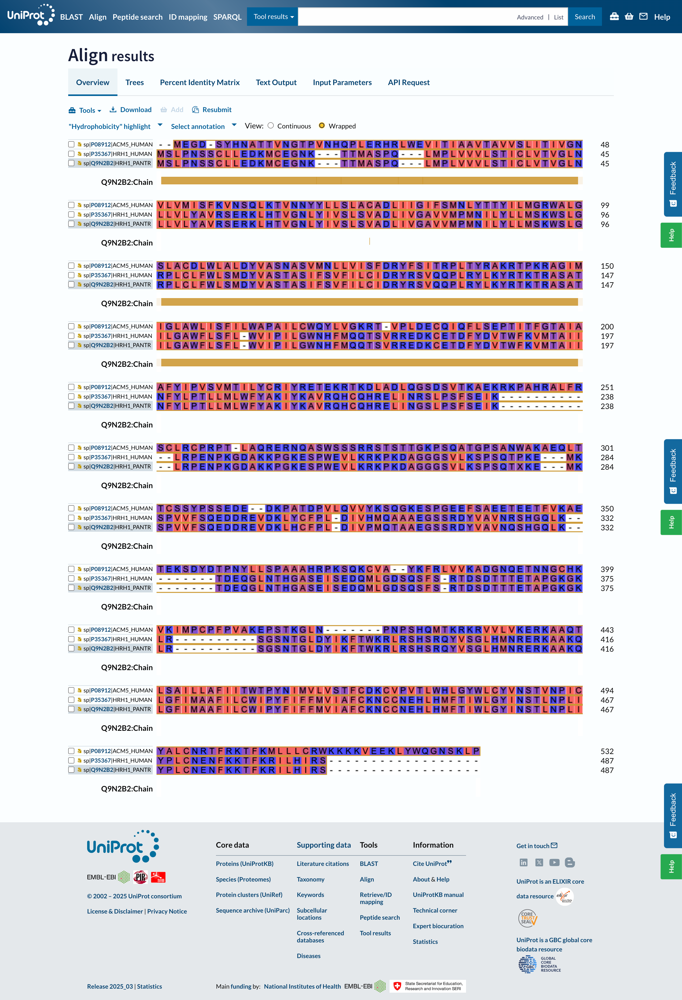
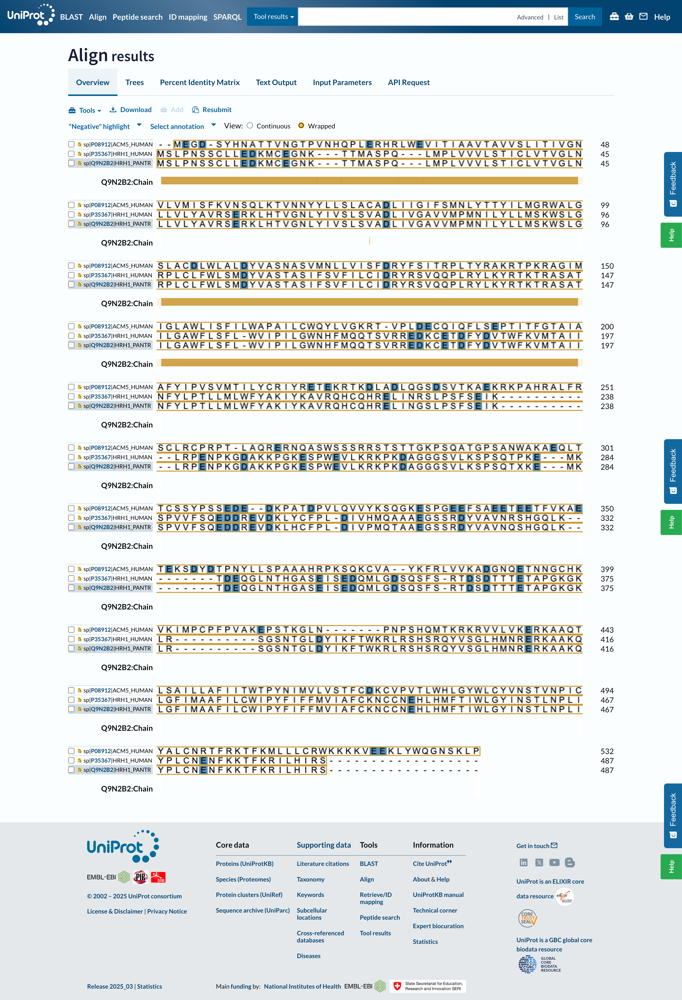
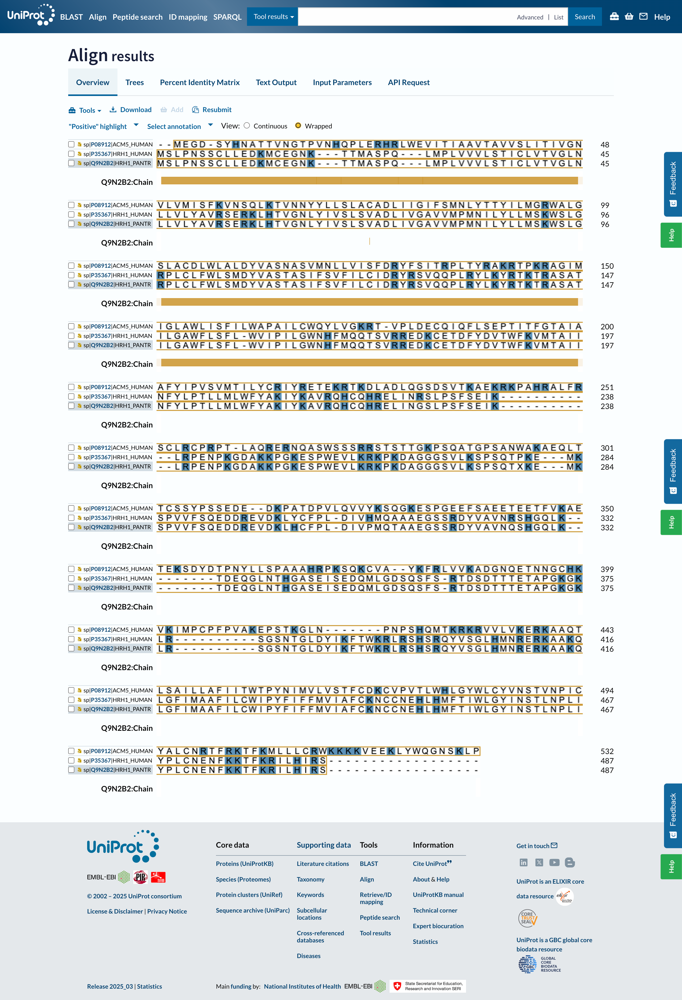
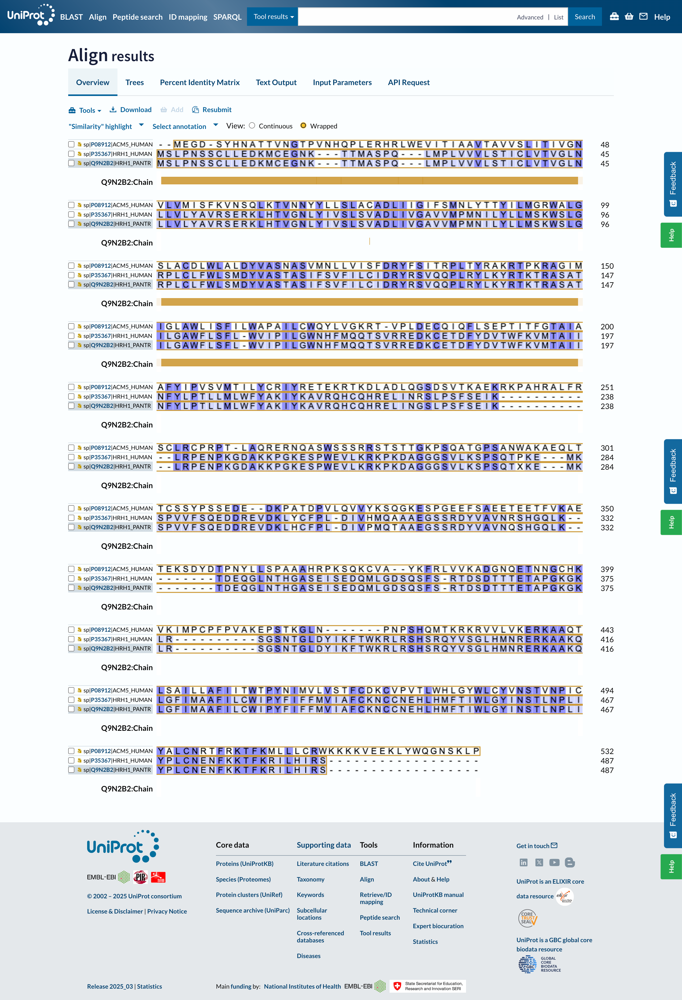

### Related proteins (off-targets), based on structure

Since we are in the fortunate position that we have a crystal structure, we are also going to use a 3D similarity search. This is a structural similarity search rather than a sequence similarity search. Now we compare proteins based on their tertiary structure (3D structure)

10.	Start at http://www.rcsb.org/pdb/home/home.do  and find your target using the PDB identifier. 
11.	Scroll down to ‘macromolecules’.
12.	Click ‘structure’

![image info](img/LAB00_FIG00.png)

13.	The top one should be your protein.
•	Write down the accession of the next most similar one
## P14416
•	In the case of a GPCR target, ignore the T4Lysozyme hits
15.	Go to: https://www.ncbi.nlm.nih.gov/Structure/icn3d/full.html use align, protein complexes, 2 PDB structures

![image info](img/LAB00_FIG01.png)

15.	Input both pdb codes and click all matching molecules superposed.

16.	After completion do file  realign and select ‘on sequence alignment’ 

17.	Select the ‘A’ chains and click realign. Note the RMSD below (realignment RMSD). 

![image info](img/LAB00_FIG02.png)

18.	Make a screenshot of the superposition. 

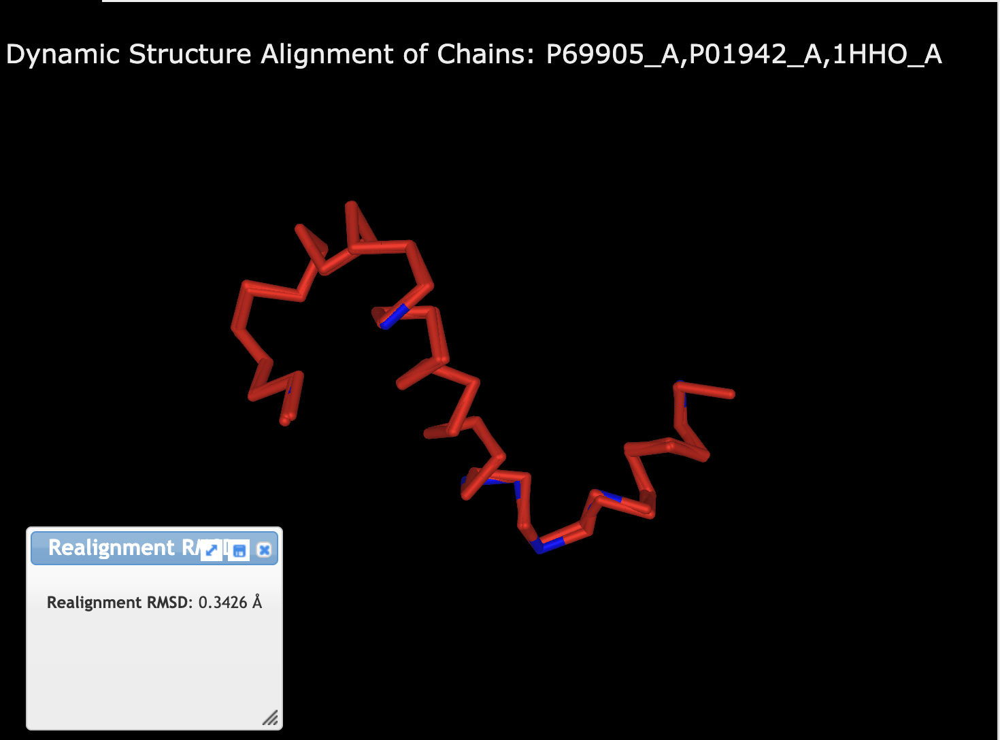

# Retrieving a 3D structure

Next, we will prepare our protein. The first step is to download it from the .pdb. We will the ngl viewer for this. 



We will add hydrogen atoms to the structure, because these are normally not resolved in the structure (due to limitations in resolution of the experimental method.

19. First, we make a working directory in your home directory:

In [2]:
from Bio.PDB import PDBParser, FastMMCIFParser, Superimposer, PDBIO, Structure
from Bio.PDB.Polypeptide import is_aa
from Bio.PDB.PDBList import PDBList

In [3]:
pdb = PDBList(server='https://files.wwpdb.org')

In [4]:
pdb.retrieve_pdb_file('3RZE', file_format='pdb', pdir='.')
#mmCif

Structure exists: './pdb3rze.ent' 


'./pdb3rze.ent'

In [5]:
def parse_structure(filepath: str) -> Structure:
    """Parse a crystal structure from a PDB or CIF file."""
    if not os.path.isfile(filepath):
        return IOError('File not found: {0}'.format(filepath))
    if filepath.endswith(('pdb', 'ent')):
        parser = PDBParser()
    elif filepath.endswith('cif'):
        parser = FastMMCIFParser()
    else:
        raise Exception('Format not supported ({0}). Must be .pdb/.ent or .cif'.format(filepath))
    basename = Path(filepath).stem
    return parser.get_structure(basename, filepath)

In [6]:
def extract_pdb_sequence(structure: Structure, with_resseq: bool = False) -> str | list[tuple[int, str]]:
    """Retrieve the 1 letter protein sequence from a PDB structure.
    
    :param structure: the PDB structure to extract sequence from
    :param with_resseq: should the amino acid indices be returned
    :returns: the protein sequence if `with_resseq` is False, otherwise a list of tuples
    whose first items are amino acid indices and whose second items are the one letter amino acid codes.
    """
    oneletter = lambda res: (res.id[1], protein_letters_3to1.get(res.resname, 'X'))
    seq = [oneletter(res) for res in structure.get_residues() if is_aa(res)]
    if not with_resseq:
        return ''.join(list(zip(*seq))[1])
    return seq

In [7]:
import os
from pathlib import Path
from Bio.Data.PDBData import protein_letters_3to1
extract_pdb_sequence(parse_structure('./pdb3rze.ent'), with_resseq=False)

'MPLVVVLSTICLVTVGLNLLVLYAVRSERKLHTVGNLYIVSLSVADLIVGAVVMPMNILYLLMSKWSLGRPLCLFWLSMDYVASTASIFSVFILCIDRYRSVQQPLRYLKYRTKTRASATILGAWFLSFLWVIPILGWNHRREDKCETDFYDVTWFKVMTAIINFYLPTLLMLWFYAKIYKAVRQHCNIFEMLRIDEGLRLKIYKDTEGYYTIGIGHLLTKSPSLNAAKSELDKAIGRNTNGVITKDEAEKLFNQDVDAAVRGILRNAKLKPVYDSLDAVRRAALINMVFQMGETGVAGFTNSLRMLQQKRWDEAAVNLAKSRWYNQTPNRAKRVITTFRTGTWDAYLHMNRERKAAKQLGFIMAAFILCWIPYFIFFMVIAFCKNCCNEHLHMFTIWLGYINSTLNPLIYPLCNENFKKTFKRILHI'

In [8]:
%pwd

'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn'

In [9]:
#parser = PDBParser()
#structure = parser.get_structure("3RZE", "pdb3rze.ent")
#io=PDBIO()
#io.set_structure(structure)
#io.save("bio-pdb-pdbio-out.pdb")


In [10]:
def extract_pdb_sequence(structure: Structure) -> str:
    """Retrieve the 1 letter protein sequence from a PDB structure."""

    oneletter = lambda res: (res.id[1], protein_letters_3to1.get(res.resname, 'X'))
    seq = [oneletter(res) for res in structure.get_residues() if is_aa(res)]
    return seq


In [11]:
extract_pdb_sequence

<function __main__.extract_pdb_sequence(structure: <module 'Bio.PDB.Structure' from '/opt/conda/lib/python3.12/site-packages/Bio/PDB/Structure.py'>) -> str>

In [12]:
HOMEDIR = str(Path.home())
os.chdir(HOMEDIR)
# We need to check whether the directory is there
try:
    os.mkdir('Bioinformatics')
except:
    print("Directory already exists")
os.chdir('Bioinformatics')

Directory already exists


Next, you need to specify the PDB code of your protein. We have used 5IU4 as an example. If you execute the code block below, you will see a viewer with a 3D structure of the protein. _*Update this for the target your group is working on!*_

In [13]:
#5IU4
TARGET_PDB_ID = "3RZE" # Enter your target PDB code here, example = '5N2R'
view = nglview.show_pdbid(TARGET_PDB_ID)
view.center()
view

NGLWidget()

It  is nice to have the overview of the structure, but since we are interested in designing new drugs, it makes more sense to have a closer look at the co-crystallized ligand. For this, we need to know the residue name of the ligand. This is a three later amino acid code that you can retrieve from the PDB. In this case, the amino acid code is ZMA. First we zoom in on the ligand.

In [14]:
#ZMA
LIGAND_CODE = "5EH" # Enter the ligand code here, example = 'zma'

view.center(LIGAND_CODE)
view

NGLWidget()

Next, let's show the residues that are within 5 Angstrom of the ligand

In [15]:
viewer.show_residues_around(view, selection=LIGAND_CODE)
view

NGLWidget()

Have a look at the residues near the ligand, can you observe any important interactions? Describe in your report which interactions you observe, and what type of interactions they are.

Note that we do not see any hydrogen atoms, do you know why?

In the next stage, we will add the hydrogens and have another look at the structure. We will split the protein and ligand and save them seperately. For this, we use biopython. https://biopython.org/docs/1.75/api/Bio.html

First download the coordinates from RCSB.

In [16]:
TARGET_PDB_ID = "3RZE" 
pdbl = PDBList()
pdbl.retrieve_pdb_file(TARGET_PDB_ID, pdir=TARGET_PDB_ID)

Structure exists: '3RZE/3rze.cif' 


'3RZE/3rze.cif'

Next, we generate a BioPython object from the coordinates, which we can use for various tasks.

In [17]:
parser = MMCIFParser()
structure = parser.get_structure("TARGETPROT",'{}/{}.cif'.format(TARGET_PDB_ID,TARGET_PDB_ID.lower()))

# Check what was loaded
print(f"Structure ID: {structure.id}")
print(f"Number of models: {len(structure)}")
print(f"Number of chains: {len(list(structure.get_chains()))}")
print(f"Number of residues: {len(list(structure.get_residues()))}")
print(f"Number of atoms: {len(list(structure.get_atoms()))}")

Structure ID: TARGETPROT
Number of models: 1
Number of chains: 1
Number of residues: 436
Number of atoms: 3555


Now we save the ligand

In [18]:
class ResSelect(Select):
    def accept_residue(self, residue):
        if residue.get_resname() == LIGAND_CODE:
            return 1
        else:
            return 0

class NonHetSelect(Select):
    def accept_residue(self, residue):
        return 1 if residue.id[0] == " " else 0

io = PDBIO()
io.set_structure(structure)
io.save("ligand-{}.pdb".format(LIGAND_CODE), ResSelect())
io.save("protein-{}.pdb".format(TARGET_PDB_ID), NonHetSelect())

# Check if files were created
import os
print(f"Ligand file exists: {os.path.exists(f'ligand-{LIGAND_CODE}.pdb')}")
print(f"Protein file exists: {os.path.exists(f'protein-{TARGET_PDB_ID}.pdb')}")

Ligand file exists: True
Protein file exists: True


Now that we have seperated ligands and protein, we can start adding hydrogens to the protein, we will use LePro for this, which is part of the LeDock program (https://en.wikipedia.org/wiki/LeDock).

21. Prepare the protein:

In [19]:
command = '../ACMDD/3_DesignYourOwn/bin/lepro'.format(TARGET_PDB_ID)
os.system(command)
shutil.move('protein-3RZE.pdb','{}_prepped.pdb'.format(TARGET_PDB_ID))

sh: 1: ../ACMDD/3_DesignYourOwn/bin/lepro: not found


'3RZE_prepped.pdb'

In [20]:
import nglview


# Make sure these variables are defined
TARGET_PDB_ID = "3RZE"  # Replace with your actual PDB ID
LIGAND_CODE = "5EH"     # Replace with your actual ligand code

# Combine protein and ligand files
filenames = [
    '{}_prepped.pdb'.format(TARGET_PDB_ID),
    "ligand-{}.pdb".format(LIGAND_CODE)
]

with open('{}-complex.pdb'.format(TARGET_PDB_ID), 'w') as outfile:
    for fname in filenames:
        with open(fname) as infile:
            for line in infile:
                if not "END" in line:
                    outfile.write(line)

# Load and visualize the complex
with open('{}-complex.pdb'.format(TARGET_PDB_ID)) as f:
    view = nglview.show_file(f, ext="pdb")

view.center(LIGAND_CODE)
view.add_representation('ball+stick', selection=LIGAND_CODE)
view.add_representation('licorice', selection='({})'.format(LIGAND_CODE, LIGAND_CODE))
viewer.show_residues_around(view, selection='ligand')
view


NGLWidget()

Let's have a look again at the protein

You can move around the structure with the mouse. Scrolling will zoom in/out, with the left mouse button you can rotate the structure. If you click the scrolling wheel you can move around the structure (sliding).

23. Now, we will repeat the procedure for the most similar target that you identified (the highest scoring hit from the PDB):

In [21]:
OFF_TARGET_PDB_ID = "6OL9" # Enter your off target PDB code here, example = '5uen'
OFF_TARGET_LIGAND = "0HK"  # Enter the ligand code here, example = 'DU1'

pdbl = PDBList()
pdbl.retrieve_pdb_file(OFF_TARGET_PDB_ID, pdir=OFF_TARGET_PDB_ID)

parser = MMCIFParser()
structure = parser.get_structure("TARGETPROT",'{}/{}.cif'.format(OFF_TARGET_PDB_ID,OFF_TARGET_PDB_ID.lower()))

class ResSelect(Select):
    def accept_residue(self, residue):
        if residue.get_resname() == OFF_TARGET_LIGAND:
            return 1
        else:
            return 0

io = PDBIO()
io.set_structure(structure)
io.save("ligand-{}.pdb".format(OFF_TARGET_LIGAND), ResSelect())
io.save("protein-{}.pdb".format(OFF_TARGET_PDB_ID), NonHetSelect())

Structure exists: '6OL9/6ol9.cif' 


In [22]:
pdbl.retrieve_pdb_file(OFF_TARGET_PDB_ID, file_format='pdb', pdir=OFF_TARGET_PDB_ID)
os.rename('{}/pdb{}.ent'.format(OFF_TARGET_PDB_ID,OFF_TARGET_PDB_ID.lower()), OFF_TARGET_PDB_ID + '.pdb')

In [23]:
!ls

3RZE			6OL9_prepped.pdb       ligand_01.pdbqt
3RZE-complex.pdb	alignment.fasta        ligand_01_docked.pdb
3RZE_prepped.pdb	dock.in		       ligand_02.mol
3rze			docking_results.pdbqt  ligand_02.pdbqt
3rze-complex-Copy1.pdb	ligand-0HK.pdb	       ligand_02_docked.pdb
3rze-complex.pdb	ligand-5EH-Copy1.pdb   pdb3rze.ent
3rze_prepped-Copy1.pdb	ligand-5EH.pdb	       protein-3rze.pdb
3rze_prepped.pdb	ligand_00.mol	       protein-6OL9.pdb
6OL9			ligand_00.pdbqt        protein.pdbqt
6OL9-complex.pdb	ligand_00_docked.pdb
6OL9.pdb		ligand_01.mol


In [24]:
%cd /home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn/

/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn


In [25]:
%pwd

'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn'

In [26]:
command = '/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn/bin/lepro {}.pdb'.format(OFF_TARGET_PDB_ID)
os.system(command)
shutil.move('pro.pdb','{}_prepped.pdb'.format(OFF_TARGET_PDB_ID))

'6OL9_prepped.pdb'

In [27]:
%pwd

'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn'

In [28]:
!ls

'00-General Information.ipynb'		     bin
'01- Bioinformatics.ipynb'		     bio-pdb-pdbio-out.pdb
'01-Introduction to Bioinformatics..ipynb'   dock.in
 02-MachineLearning.ipynb		     environment.yml
 03-Docking.ipynb			     img
 2oh4.cif				     new_02-MachineLearning.ipynb
 6OL9-complex.pdb			     new_03-Docking.ipynb
 6OL9_prepped.pdb			     oh
 CHEMBL205.tsv				     pdb2oh4.ent
 Chembl_activities1.tsv			     pdb3rze.ent
'Final Report.ipynb'			     results
 README.md				     scripts
 Untitled.py


In [29]:
%cd /home/jovyan/Bioinformatics/

/home/jovyan/Bioinformatics


In [30]:
# combine protein and ligand files
filenames = [
'{}_prepped.pdb'.format(OFF_TARGET_PDB_ID),
"ligand-{}.pdb".format(OFF_TARGET_LIGAND)
]
with open('{}-complex.pdb'.format(OFF_TARGET_PDB_ID), 'w') as outfile:
    for fname in filenames:
        with open(fname) as infile:
            for line in infile:
                if not "END" in line:
                    outfile.write(line)

# Check if files were created
import os
print(f"Ligand file exists: {os.path.exists(f'ligand-{LIGAND_CODE}.pdb')}")
print(f"Protein file exists: {os.path.exists(f'protein-{TARGET_PDB_ID}.pdb')}")

Ligand file exists: True
Protein file exists: False


24. Prepare the protein

In [31]:
with open('{}-complex.pdb'.format(OFF_TARGET_PDB_ID)) as f:
    view = nglview.show_file(f, ext="pdb")
    
view.center(OFF_TARGET_LIGAND)
viewer.show_residues_around(view, selection=OFF_TARGET_LIGAND)
view

NGLWidget()

25. Now, let's try to align the structures. First we generate the alignment object

In [32]:
from Bio import pairwise2
from Bio.Seq import Seq 
from Bio.SeqRecord import SeqRecord
from Bio.Align import MultipleSeqAlignment

# Get the structures
PDBCODE_1 = '3RZE' # Name of the first structure
PDBCODE_2 = '6OL9' # Name of the second structure

import requests
data = requests.get(f'https://www.ebi.ac.uk/pdbe/api/pdb/entry/molecules/{PDBCODE_1}').json()[PDBCODE_1.lower()]
SEQ1 = (data[0]['sequence'])
SEQ1 = Seq(SEQ1)

data = requests.get(f'https://www.ebi.ac.uk/pdbe/api/pdb/entry/molecules/{PDBCODE_2}').json()[PDBCODE_2.lower()]
SEQ2 = (data[0]['sequence'])
SEQ2 = Seq(SEQ2)

alignments = pairwise2.align.globalxx(SEQ1, SEQ2)

for align1, align2, score, begin, end in alignments:
    filename = "alignment.fasta"
    with open(filename, "w") as handle:
        handle.write(">SEQ1\n%s\n>SEQ2\n%s\n" % (align1, align2))

print(alignments[0])


Alignment(seqA='TTM-ASPQLMP----L--V-----V--VL-STICLV-T-VGLNLLVLYAVR--SER-K----LH-TVGNL-YIVS-L-SV-A--DLIV-GAVVMP---MNILYL----LMSK--WS-LGRP-L-C-LFWLSM--DYVAST-ASIFS-VFI--LC--I--DRYR-SVQQ---PLR-YL--KYRT-KTRASAT-IL--G-AWFL-SF-LWVI-P-ILG-WNHFMQQTS--VR--RE----DK-C------E-TDFYDV-TWFKVM-TAIIN--FYL-PTLL---M--LWFYAK--IY----KAVRQHC-NIFEMLRIDEGLRLKIYKDTEGYYTIGIGHLLTKSPSLNAAKSELDKAIGRNT-NGVITKDEAEKLFNQDVDAAVRGILRNAKLKPVYDSLDAVRRAALINMVFQMGETGVAGFTNSLRMLQQKRWDEAAVNLAKSRWYNQTPNRAKRVITTFRTGTWDAYLHMNR-----ERKAAKQ-LGFIM-A---AFILCWI---PYF-IFFMVIA----FC-KNCCNEHLHMF---TI-W-LGYI-----NSTL-NPLI-YP-LCNEN--FK-KTFKRI-LHI---RSG------EN--LYF-Q------------------', seqB='---GA-P-L--ERHRLWEVITIAAVTAV-VS---L-ITIVG-N--VL--V-MIS--FKVNSQL-KTV-N-NY---YLLS-LACADLI-IG-----IFSMN-LY-TTYILM--GRW-ALG--SLACDL-WL--ALDYVAS-NA----RV--MNL-LVISFDRY-FS---ITRPL-TY-RAK-RTPK-R--A-GI-MIGLAW-LISFILW--APAIL-CW-----Q--YLV-GKR-TVPLD-ECQIQFLSEPT-----IT-F---GTA-I-AAFY-IP---VSVMTIL--Y--CRIYRETEK--R---TNIFEMLRIDEGLRLKIYKDTEGYYTIGIGHLLTKSPSLNAAKSE

You can also align structure using https://www.ncbi.nlm.nih.gov/Structure/icn3d/full.html as you've seen previously.

You can also have a look at PLIP, which is a nice interaction profiler as well:
https://plip-tool.biotec.tu-dresden.de/plip-web/plip/index

Finally, the interaction viewer on rcsb itself is also quite good, just type in your accession code in the search bar, scroll down to the ligand overview and click the ligand interaction box.

Toy around a bit with the structures and see if you can get a feeling for the binding site. In particular what kind of interactions seem to be important. Feel free to discuss this with your supervisor as well!

Another great way to look at the structure is on the rcsb website itself, where you can go to a 3D viewer of the ligand binding site by clicking on the Ligand interaction button. 



This is the end of the bioinformatics part of the lab, for the report, please add a screenshot of the PLIP viewer. Try to identify key interactions in the binding site, either on the RCSB website or PLIP. Also think already how you might improve the ligand, can you think of additional interactions? The next two days, we will try to optimize the ligand. Tomorrow we will work with QSAR and cheminformatics. The day after we will use docking

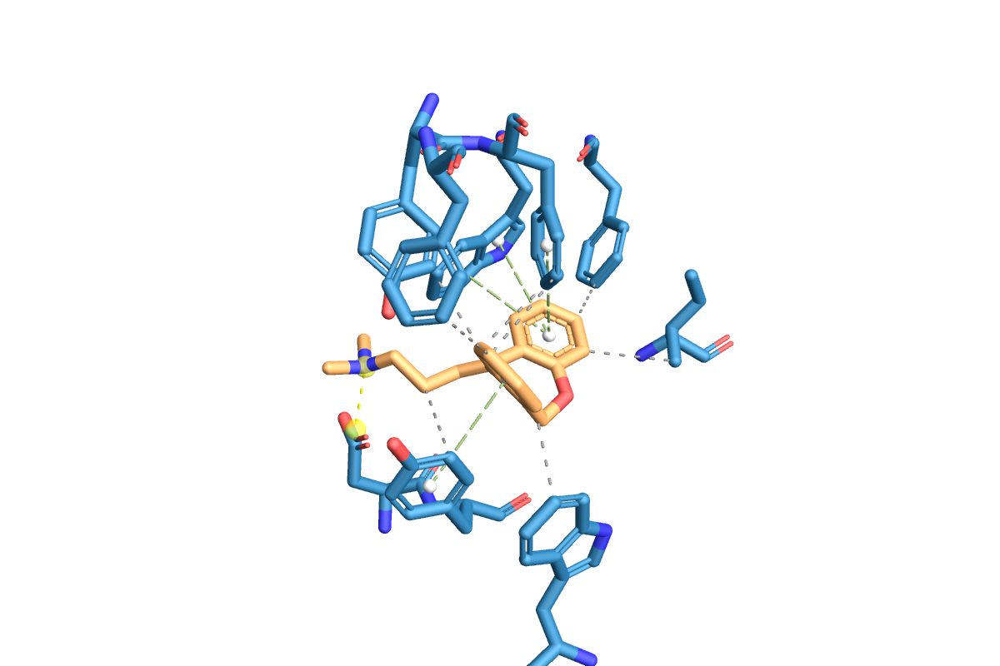

# Retrieving a 3D structure

Next, we will prepare our protein. The first step is to download it from the .pdb. We will the ngl viewer for this. 



We will add hydrogen atoms to the structure, because these are normally not resolved in the structure (due to limitations in resolution of the experimental method.

19. First, we make a working directory in your home directory:

In [34]:
from Bio.PDB import PDBParser, FastMMCIFParser, Superimposer, PDBIO, Structure
from Bio.PDB.Polypeptide import is_aa
from Bio.PDB.PDBList import PDBList

In [35]:
pdb = PDBList(server='https://files.wwpdb.org')

In [36]:
pdb.retrieve_pdb_file('3RZE', file_format='pdb', pdir='.')
#mmCif

Structure exists: './pdb3rze.ent' 


'./pdb3rze.ent'

In [37]:
def parse_structure(filepath: str) -> Structure:
    """Parse a crystal structure from a PDB or CIF file."""
    if not os.path.isfile(filepath):
        return IOError('File not found: {0}'.format(filepath))
    if filepath.endswith(('pdb', 'ent')):
        parser = PDBParser()
    elif filepath.endswith('cif'):
        parser = FastMMCIFParser()
    else:
        raise Exception('Format not supported ({0}). Must be .pdb/.ent or .cif'.format(filepath))
    basename = Path(filepath).stem
    return parser.get_structure(basename, filepath)

In [38]:
def extract_pdb_sequence(structure: Structure, with_resseq: bool = False) -> str | list[tuple[int, str]]:
    """Retrieve the 1 letter protein sequence from a PDB structure.
    
    :param structure: the PDB structure to extract sequence from
    :param with_resseq: should the amino acid indices be returned
    :returns: the protein sequence if `with_resseq` is False, otherwise a list of tuples
    whose first items are amino acid indices and whose second items are the one letter amino acid codes.
    """
    oneletter = lambda res: (res.id[1], protein_letters_3to1.get(res.resname, 'X'))
    seq = [oneletter(res) for res in structure.get_residues() if is_aa(res)]
    if not with_resseq:
        return ''.join(list(zip(*seq))[1])
    return seq

In [39]:
import os
from pathlib import Path
from Bio.Data.PDBData import protein_letters_3to1
extract_pdb_sequence(parse_structure('./pdb3rze.ent'), with_resseq=False)

'MPLVVVLSTICLVTVGLNLLVLYAVRSERKLHTVGNLYIVSLSVADLIVGAVVMPMNILYLLMSKWSLGRPLCLFWLSMDYVASTASIFSVFILCIDRYRSVQQPLRYLKYRTKTRASATILGAWFLSFLWVIPILGWNHRREDKCETDFYDVTWFKVMTAIINFYLPTLLMLWFYAKIYKAVRQHCNIFEMLRIDEGLRLKIYKDTEGYYTIGIGHLLTKSPSLNAAKSELDKAIGRNTNGVITKDEAEKLFNQDVDAAVRGILRNAKLKPVYDSLDAVRRAALINMVFQMGETGVAGFTNSLRMLQQKRWDEAAVNLAKSRWYNQTPNRAKRVITTFRTGTWDAYLHMNRERKAAKQLGFIMAAFILCWIPYFIFFMVIAFCKNCCNEHLHMFTIWLGYINSTLNPLIYPLCNENFKKTFKRILHI'

In [40]:
%pwd

'/home/jovyan/Bioinformatics'

In [41]:
#parser = PDBParser()
#structure = parser.get_structure("3RZE", "pdb3rze.ent")
#io=PDBIO()
#io.set_structure(structure)
#io.save("bio-pdb-pdbio-out.pdb")


In [42]:
%pwd


'/home/jovyan/Bioinformatics'

In [43]:
def extract_pdb_sequence(structure: Structure) -> str:
    """Retrieve the 1 letter protein sequence from a PDB structure."""

    oneletter = lambda res: (res.id[1], protein_letters_3to1.get(res.resname, 'X'))
    seq = [oneletter(res) for res in structure.get_residues() if is_aa(res)]
    return seq


In [44]:
extract_pdb_sequence

<function __main__.extract_pdb_sequence(structure: <module 'Bio.PDB.Structure' from '/opt/conda/lib/python3.12/site-packages/Bio/PDB/Structure.py'>) -> str>

In [45]:
HOMEDIR = str(Path.home())
os.chdir(HOMEDIR)
# We need to check whether the directory is there
try:
    os.mkdir('Bioinformatics')
except:
    print("Directory already exists")
os.chdir('Bioinformatics')

Directory already exists


Next, you need to specify the PDB code of your protein. We have used 5IU4 as an example. If you execute the code block below, you will see a viewer with a 3D structure of the protein. _*Update this for the target your group is working on!*_

In [46]:
#5IU4
TARGET_PDB_ID = "3RZE" # Enter your target PDB code here, example = '5N2R'
view = nglview.show_pdbid(TARGET_PDB_ID)
view.center()
view

NGLWidget()

It  is nice to have the overview of the structure, but since we are interested in designing new drugs, it makes more sense to have a closer look at the co-crystallized ligand. For this, we need to know the residue name of the ligand. This is a three later amino acid code that you can retrieve from the PDB. In this case, the amino acid code is ZMA. First we zoom in on the ligand.

In [47]:
#ZMA
LIGAND_CODE = "5EH" # Enter the ligand code here, example = 'zma'

view.center(LIGAND_CODE)
view

NGLWidget()

Next, let's show the residues that are within 5 Angstrom of the ligand

In [48]:
viewer.show_residues_around(view, selection=LIGAND_CODE)
view

NGLWidget()

Have a look at the residues near the ligand, can you observe any important interactions? Describe in your report which interactions you observe, and what type of interactions they are.

Note that we do not see any hydrogen atoms, do you know why?

In the next stage, we will add the hydrogens and have another look at the structure. We will split the protein and ligand and save them seperately. For this, we use biopython. https://biopython.org/docs/1.75/api/Bio.html

First download the coordinates from RCSB.

In [49]:
TARGET_PDB_ID = "3RZE" 
pdbl = PDBList()
pdbl.retrieve_pdb_file(TARGET_PDB_ID, pdir=TARGET_PDB_ID)

Structure exists: '3RZE/3rze.cif' 


'3RZE/3rze.cif'

Next, we generate a BioPython object from the coordinates, which we can use for various tasks.

In [50]:
parser = MMCIFParser()
structure = parser.get_structure("TARGETPROT",'{}/{}.cif'.format(TARGET_PDB_ID,TARGET_PDB_ID.lower()))

# Check what was loaded
print(f"Structure ID: {structure.id}")
print(f"Number of models: {len(structure)}")
print(f"Number of chains: {len(list(structure.get_chains()))}")
print(f"Number of residues: {len(list(structure.get_residues()))}")
print(f"Number of atoms: {len(list(structure.get_atoms()))}")

Structure ID: TARGETPROT
Number of models: 1
Number of chains: 1
Number of residues: 436
Number of atoms: 3555


Now we save the ligand

In [51]:
class ResSelect(Select):
    def accept_residue(self, residue):
        if residue.get_resname() == LIGAND_CODE:
            return 1
        else:
            return 0

class NonHetSelect(Select):
    def accept_residue(self, residue):
        return 1 if residue.id[0] == " " else 0

io = PDBIO()
io.set_structure(structure)
io.save("ligand-{}.pdb".format(LIGAND_CODE), ResSelect())
io.save("protein-{}.pdb".format(TARGET_PDB_ID), NonHetSelect())

# Check if files were created
import os
print(f"Ligand file exists: {os.path.exists(f'ligand-{LIGAND_CODE}.pdb')}")
print(f"Protein file exists: {os.path.exists(f'protein-{TARGET_PDB_ID}.pdb')}")

Ligand file exists: True
Protein file exists: True


Now that we have seperated ligands and protein, we can start adding hydrogens to the protein, we will use LePro for this, which is part of the LeDock program (https://en.wikipedia.org/wiki/LeDock).

21. Prepare the protein:

In [52]:
command = '../ACMDD/3_DesignYourOwn/bin/lepro'.format(TARGET_PDB_ID)
os.system(command)
shutil.move('protein-3RZE.pdb','{}_prepped.pdb'.format(TARGET_PDB_ID))

sh: 1: ../ACMDD/3_DesignYourOwn/bin/lepro: not found


'3RZE_prepped.pdb'

In [53]:
import nglview


# Make sure these variables are defined
TARGET_PDB_ID = "3RZE"  # Replace with your actual PDB ID
LIGAND_CODE = "5EH"     # Replace with your actual ligand code

# Combine protein and ligand files
filenames = [
    '{}_prepped.pdb'.format(TARGET_PDB_ID),
    "ligand-{}.pdb".format(LIGAND_CODE)
]

with open('{}-complex.pdb'.format(TARGET_PDB_ID), 'w') as outfile:
    for fname in filenames:
        with open(fname) as infile:
            for line in infile:
                if not "END" in line:
                    outfile.write(line)

# Load and visualize the complex
with open('{}-complex.pdb'.format(TARGET_PDB_ID)) as f:
    view = nglview.show_file(f, ext="pdb")

view.center(LIGAND_CODE)
view.add_representation('ball+stick', selection=LIGAND_CODE)
view.add_representation('licorice', selection='({})'.format(LIGAND_CODE, LIGAND_CODE))
viewer.show_residues_around(view, selection='ligand')
view


NGLWidget()

Let's have a look again at the protein

You can move around the structure with the mouse. Scrolling will zoom in/out, with the left mouse button you can rotate the structure. If you click the scrolling wheel you can move around the structure (sliding).

23. Now, we will repeat the procedure for the most similar target that you identified (the highest scoring hit from the PDB):

In [54]:
OFF_TARGET_PDB_ID = "6OL9" # Enter your off target PDB code here, example = '5uen'
OFF_TARGET_LIGAND = "0HK"  # Enter the ligand code here, example = 'DU1'

pdbl = PDBList()
pdbl.retrieve_pdb_file(OFF_TARGET_PDB_ID, pdir=OFF_TARGET_PDB_ID)

parser = MMCIFParser()
structure = parser.get_structure("TARGETPROT",'{}/{}.cif'.format(OFF_TARGET_PDB_ID,OFF_TARGET_PDB_ID.lower()))

class ResSelect(Select):
    def accept_residue(self, residue):
        if residue.get_resname() == OFF_TARGET_LIGAND:
            return 1
        else:
            return 0

io = PDBIO()
io.set_structure(structure)
io.save("ligand-{}.pdb".format(OFF_TARGET_LIGAND), ResSelect())
io.save("protein-{}.pdb".format(OFF_TARGET_PDB_ID), NonHetSelect())

Structure exists: '6OL9/6ol9.cif' 


In [55]:
pdbl.retrieve_pdb_file(OFF_TARGET_PDB_ID, file_format='pdb', pdir=OFF_TARGET_PDB_ID)
os.rename('{}/pdb{}.ent'.format(OFF_TARGET_PDB_ID,OFF_TARGET_PDB_ID.lower()), OFF_TARGET_PDB_ID + '.pdb')

In [56]:
%pwd

'/home/jovyan/Bioinformatics'

In [57]:
!ls

3RZE			6OL9_prepped.pdb       ligand_01.pdbqt
3RZE-complex.pdb	alignment.fasta        ligand_01_docked.pdb
3RZE_prepped.pdb	dock.in		       ligand_02.mol
3rze			docking_results.pdbqt  ligand_02.pdbqt
3rze-complex-Copy1.pdb	ligand-0HK.pdb	       ligand_02_docked.pdb
3rze-complex.pdb	ligand-5EH-Copy1.pdb   pdb3rze.ent
3rze_prepped-Copy1.pdb	ligand-5EH.pdb	       protein-3rze.pdb
3rze_prepped.pdb	ligand_00.mol	       protein-6OL9.pdb
6OL9			ligand_00.pdbqt        protein.pdbqt
6OL9-complex.pdb	ligand_00_docked.pdb
6OL9.pdb		ligand_01.mol


In [58]:
%cd /home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn/

/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn


In [59]:
%pwd

'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn'

In [60]:
command = '/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn/bin/lepro {}.pdb'.format(OFF_TARGET_PDB_ID)
os.system(command)
shutil.move('pro.pdb','{}_prepped.pdb'.format(OFF_TARGET_PDB_ID))

'6OL9_prepped.pdb'

In [61]:
%pwd

'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn'

In [62]:
!ls

'00-General Information.ipynb'		     bin
'01- Bioinformatics.ipynb'		     bio-pdb-pdbio-out.pdb
'01-Introduction to Bioinformatics..ipynb'   dock.in
 02-MachineLearning.ipynb		     environment.yml
 03-Docking.ipynb			     img
 2oh4.cif				     new_02-MachineLearning.ipynb
 6OL9-complex.pdb			     new_03-Docking.ipynb
 6OL9_prepped.pdb			     oh
 CHEMBL205.tsv				     pdb2oh4.ent
 Chembl_activities1.tsv			     pdb3rze.ent
'Final Report.ipynb'			     results
 README.md				     scripts
 Untitled.py


In [63]:
%cd /home/jovyan/Bioinformatics/

/home/jovyan/Bioinformatics


In [64]:
# combine protein and ligand files
filenames = [
'{}_prepped.pdb'.format(OFF_TARGET_PDB_ID),
"ligand-{}.pdb".format(OFF_TARGET_LIGAND)
]
with open('{}-complex.pdb'.format(OFF_TARGET_PDB_ID), 'w') as outfile:
    for fname in filenames:
        with open(fname) as infile:
            for line in infile:
                if not "END" in line:
                    outfile.write(line)

# Check if files were created
import os
print(f"Ligand file exists: {os.path.exists(f'ligand-{LIGAND_CODE}.pdb')}")
print(f"Protein file exists: {os.path.exists(f'protein-{TARGET_PDB_ID}.pdb')}")

Ligand file exists: True
Protein file exists: False


24. Prepare the protein

In [65]:
with open('{}-complex.pdb'.format(OFF_TARGET_PDB_ID)) as f:
    view = nglview.show_file(f, ext="pdb")
    
view.center(OFF_TARGET_LIGAND)
viewer.show_residues_around(view, selection=OFF_TARGET_LIGAND)
view

NGLWidget()

25. Now, let's try to align the structures. First we generate the alignment object

In [66]:
from Bio import pairwise2
from Bio.Seq import Seq 
from Bio.SeqRecord import SeqRecord
from Bio.Align import MultipleSeqAlignment

# Get the structures
PDBCODE_1 = '3RZE' # Name of the first structure
PDBCODE_2 = '6OL9' # Name of the second structure

import requests
data = requests.get(f'https://www.ebi.ac.uk/pdbe/api/pdb/entry/molecules/{PDBCODE_1}').json()[PDBCODE_1.lower()]
SEQ1 = (data[0]['sequence'])
SEQ1 = Seq(SEQ1)

data = requests.get(f'https://www.ebi.ac.uk/pdbe/api/pdb/entry/molecules/{PDBCODE_2}').json()[PDBCODE_2.lower()]
SEQ2 = (data[0]['sequence'])
SEQ2 = Seq(SEQ2)

alignments = pairwise2.align.globalxx(SEQ1, SEQ2)

for align1, align2, score, begin, end in alignments:
    filename = "alignment.fasta"
    with open(filename, "w") as handle:
        handle.write(">SEQ1\n%s\n>SEQ2\n%s\n" % (align1, align2))

print(alignments[0])


Alignment(seqA='TTM-ASPQLMP----L--V-----V--VL-STICLV-T-VGLNLLVLYAVR--SER-K----LH-TVGNL-YIVS-L-SV-A--DLIV-GAVVMP---MNILYL----LMSK--WS-LGRP-L-C-LFWLSM--DYVAST-ASIFS-VFI--LC--I--DRYR-SVQQ---PLR-YL--KYRT-KTRASAT-IL--G-AWFL-SF-LWVI-P-ILG-WNHFMQQTS--VR--RE----DK-C------E-TDFYDV-TWFKVM-TAIIN--FYL-PTLL---M--LWFYAK--IY----KAVRQHC-NIFEMLRIDEGLRLKIYKDTEGYYTIGIGHLLTKSPSLNAAKSELDKAIGRNT-NGVITKDEAEKLFNQDVDAAVRGILRNAKLKPVYDSLDAVRRAALINMVFQMGETGVAGFTNSLRMLQQKRWDEAAVNLAKSRWYNQTPNRAKRVITTFRTGTWDAYLHMNR-----ERKAAKQ-LGFIM-A---AFILCWI---PYF-IFFMVIA----FC-KNCCNEHLHMF---TI-W-LGYI-----NSTL-NPLI-YP-LCNEN--FK-KTFKRI-LHI---RSG------EN--LYF-Q------------------', seqB='---GA-P-L--ERHRLWEVITIAAVTAV-VS---L-ITIVG-N--VL--V-MIS--FKVNSQL-KTV-N-NY---YLLS-LACADLI-IG-----IFSMN-LY-TTYILM--GRW-ALG--SLACDL-WL--ALDYVAS-NA----RV--MNL-LVISFDRY-FS---ITRPL-TY-RAK-RTPK-R--A-GI-MIGLAW-LISFILW--APAIL-CW-----Q--YLV-GKR-TVPLD-ECQIQFLSEPT-----IT-F---GTA-I-AAFY-IP---VSVMTIL--Y--CRIYRETEK--R---TNIFEMLRIDEGLRLKIYKDTEGYYTIGIGHLLTKSPSLNAAKSE

## 2_ MachineLearning

In [67]:
# We will load some libraries again first

import os
from pathlib import Path
from warnings import filterwarnings
import time

import pandas as pd
import numpy as np
from sklearn import svm, metrics, clone
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import auc, accuracy_score, recall_score
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from rdkit import Chem
from rdkit.Chem import MACCSkeys, AllChem

#from teachopencadd.utils import seed_everything

# Silence some expected warnings
filterwarnings("ignore")
# Fix seed for reproducible results
SEED = 22
#seed_everything(SEED)

In [68]:
import os
from pathlib import Path
HOMEDIR = str(Path.home())
os.chdir(HOMEDIR)
# We need to check whether the directory is there
try:
    os.mkdir('Cheminformatics')
except:
    print("Directory already exists")
os.chdir('Cheminformatics')

Directory already exists


For this next part, we need to have the SMILES (https://en.wikipedia.org/wiki/Simplified_molecular-input_line-entry_system) representation of the molecule. You can retrieve this by going to the pdb, and fetch the InChI key for the ligand in your structure (use the RCSB accession code).

4. The image below shows the InChI key for zma241385 in blue:
![image info](img/LAB01_FIG00.png)

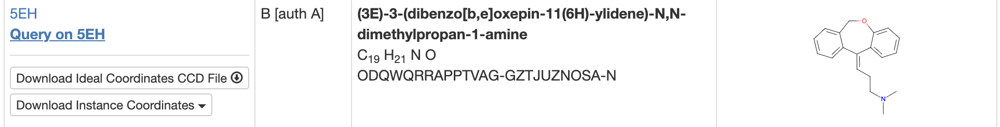

In [69]:
os.chdir(Path(_dh[0]))

In [70]:
CHEMBLID = 'CHEMBL321' # Enter the CHEMBL ID of your target here
FILENAME = 'Chembl_activities1.tsv' # The filename of the uploaded file

data = pd.read_csv(FILENAME, sep='\t')

print("There are a total of {} datapoints in this set".format(len(data)))
data.head()

There are a total of 8082 datapoints in this set


,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,Standard Relation,...,Document ChEMBL ID,Source ID,Source Description,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value,Value
0,CHEMBL2208420,NaN,NaN,405.33,1.0,5.18,12,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,Ki,'=',...,CHEMBL2202969,1,Scientific Literature,Bioorg Med Chem Lett,2012.0,CHEMBL3307512,NaN,NaN,NaN,7.9
1,CHEMBL2208420,NaN,NaN,405.33,1.0,5.18,12,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,Inhibition,'>',...,CHEMBL2202969,1,Scientific Literature,Bioorg Med Chem Lett,2012.0,CHEMBL3307512,NaN,NaN,NaN,70.0
2,CHEMBL2208418,NaN,NaN,466.43,0.0,4.60,10,O[C@@H](CNC1CCN(Cc2ccc(Cl)c(Cl)c2)CC1)COc1ccc2...,Inhibition,'>',...,CHEMBL2202969,1,Scientific Literature,Bioorg Med Chem Lett,2012.0,CHEMBL3307512,NaN,NaN,NaN,70.0
3,CHEMBL1081319,NaN,NaN,310.40,0.0,1.99,50,N#C/N=C(/NCCCCc1ccccc1)NCCc1c[nH]cn1,pKb,NaN,...,CHEMBL1154326,1,Scientific Literature,J Med Chem,2009.0,CHEMBL3308860,NaN,NaN,NaN,NaN
4,CHEMBL511,PYRILAMINE,4.0,285.39,0.0,2.66,Mepyramine,COc1ccc(CN(CCN(C)C)c2ccccn2)cc1,Activity,NaN,...,CHEMBL1221171,1,Scientific Literature,Nat Chem Biol,2005.0,NaN,NaN,NaN,NaN,NaN


In [71]:
pd_data = data[['Molecule ChEMBL ID','pChEMBL Value','Smiles','Assay Type', 'Standard Relation','Standard Value']]
pd_data.rename(columns={'pChEMBL Value': 'pChEMBL_value', 'Assay Type':'Assay_Type'}, inplace=True)
pd_data.head()

,Molecule ChEMBL ID,pChEMBL_value,Smiles,Assay_Type,Standard Relation,Standard Value
0,CHEMBL2208420,7.9,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,B,'=',12.59
1,CHEMBL2208420,NaN,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,B,'>',70.00
2,CHEMBL2208418,NaN,O[C@@H](CNC1CCN(Cc2ccc(Cl)c(Cl)c2)CC1)COc1ccc2...,B,'>',70.00
3,CHEMBL1081319,NaN,N#C/N=C(/NCCCCc1ccccc1)NCCc1c[nH]cn1,F,NaN,NaN
4,CHEMBL511,NaN,COc1ccc(CN(CCN(C)C)c2ccccn2)cc1,F,NaN,NaN


In [72]:
import numpy as np
# Add column for activity
pd_data["active"] = np.zeros(len(pd_data))

# Mark every molecule as active with an pCHEMBL of >= 6.5, 0 otherwise
pd_data.loc[pd_data[pd_data.pChEMBL_value >= 6.5].index, "active"] = 1.0

# NBVAL_CHECK_OUTPUT
print("Number of active compounds:", int(pd_data.active.sum()))
print("Number of inactive compounds:", len(pd_data) - int(pd_data.active.sum()))

Number of active compounds: 1451
Number of inactive compounds: 6631


In [73]:
pd_data.drop(pd_data[pd_data.Assay_Type != 'B'].index, inplace=True)

print("We have a total of {} activity points left".format(len(pd_data)))

We have a total of 6648 activity points left


In [74]:
# Set path to this notebook
HERE = Path(_dh[-1])
DATA = HERE / "data"

#### Molecule encoding

Now we define a function `smiles_to_fp` to generate fingerprints from SMILES.
For now, we incorporated the choice between the following fingerprints:

* maccs
* morgan2 and morgan3

In [75]:
def smiles_to_fp(smiles, method="maccs", n_bits=2048):
    """
    Encode a molecule from a SMILES string into a fingerprint.

    Parameters
    ----------
    smiles : str
        The SMILES string defining the molecule.

    method : str
        The type of fingerprint to use. Default is MACCS keys.

    n_bits : int
        The length of the fingerprint.

    Returns
    -------
    array
        The fingerprint array.

    """

    # convert smiles to RDKit mol object
    try:
        mol = Chem.MolFromSmiles(smiles)
        
    except:
        return np.nan

    if method == "maccs":
        return np.array(MACCSkeys.GenMACCSKeys(mol))
    if method == "morgan2":
        fingerprinter = AllChem.GetMorganGenerator(radius=2, fpSize=n_bits)
        return np.array(fingerprinter.GetFingerprint(mol))
    if method == "morgan3":
        fingerprinter = AllChem.GetMorganGenerator(radius=3, fpSize=n_bits)
        return np.array(fingerprinter.GetFingerprint(mol))
    else:
        # NBVAL_CHECK_OUTPUT
        print(f"Warning: Wrong method specified: {method}. Default will be used instead.")
        return np.array(MACCSkeys.GenMACCSKeys(mol))

In [76]:
compound_df = pd_data.copy()

In [77]:
# Add column for fingerprint
compound_df["fp"] = compound_df["Smiles"].apply(smiles_to_fp)
compound_df.dropna(subset="fp", inplace=True)
compound_df.head(3)
# NBVAL_CHECK_OUTPUT

,Molecule ChEMBL ID,pChEMBL_value,Smiles,Assay_Type,Standard Relation,Standard Value,active,fp
0,CHEMBL2208420,7.9,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,B,'=',12.59,1.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,CHEMBL2208420,NaN,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,B,'>',70.00,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,CHEMBL2208418,NaN,O[C@@H](CNC1CCN(Cc2ccc(Cl)c(Cl)c2)CC1)COc1ccc2...,B,'>',70.00,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."


### Machine Learning (ML)

In the following, we will try several ML approaches to classify our molecules. We will use:

* Random Forest (RF)
* Support Vector Machine (SVM) 
* Artificial Neural Network (ANN) 

Additionally, we will comment on the results.

The goal is to test the ability of the model to predict data which it has never seen before in order to flag problems known as over fitting and to assess the generalization ability of the model.

We start by defining a function `model_training_and_validation` which fits a model on a random train-test split of the data and returns measures such as accuracy, sensitivity, specificity and AUC evaluated on the test set. We also plot the ROC curves using `plot_roc_curves_for_models`.

We then define a function named `crossvalidation` which executes a cross validation procedure and prints the statistics of the results over the folds.

In [78]:
def plot_roc_curves_for_models(models, test_x, test_y, save_png=True):
    """
    Helper function to plot customized roc curve.

    Parameters
    ----------
    models: dict
        Dictionary of pretrained machine learning models.
    test_x: list
        Molecular fingerprints for test set.
    test_y: list
        Associated activity labels for test set.
    save_png: bool
        Save image to disk (default = False)

    Returns
    -------
    fig:
        Figure.
    """

    fig, ax = plt.subplots()

    # Below for loop iterates through your models list
    for model in models:
        # Select the model
        ml_model = model["model"]
        # Prediction probability on test set
        test_prob = ml_model.predict_proba(test_x)[:, 1]
        # Prediction class on test set
        test_pred = ml_model.predict(test_x)
        # Compute False postive rate and True positive rate
        fpr, tpr, thresholds = metrics.roc_curve(test_y, test_prob)
        # Calculate Area under the curve to display on the plot
        auc = roc_auc_score(test_y, test_prob)
        # Plot the computed values
        ax.plot(fpr, tpr, label=(f"{model['label']} AUC area = {auc:.2f}"))

    # Custom settings for the plot
    ax.plot([0, 1], [0, 1], "r--")
    ax.set_xlabel("False Positive Rate")
    ax.set_ylabel("True Positive Rate")
    ax.set_title("Receiver Operating Characteristic")
    ax.legend(loc="lower right")
    # Save plot
    if save_png:
        fig.savefig(f"results/roc_auc", dpi=300, bbox_inches="tight", transparent=True)
    return fig

In [79]:
def model_performance(ml_model, test_x, test_y, verbose=True):
    """
    Helper function to calculate model performance

    Parameters
    ----------
    ml_model: sklearn model object
        The machine learning model to train.
    test_x: list
        Molecular fingerprints for test set.
    test_y: list
        Associated activity labels for test set.
    verbose: bool
        Print performance measure (default = True)

    Returns
    -------
    tuple:
        Accuracy, sensitivity, specificity, auc on test set.
    """

    # Prediction probability on test set
    test_prob = ml_model.predict_proba(test_x)[:, 1]

    # Prediction class on test set
    test_pred = ml_model.predict(test_x)

    # Performance of model on test set
    accuracy = accuracy_score(test_y, test_pred)
    sens = recall_score(test_y, test_pred)
    spec = recall_score(test_y, test_pred, pos_label=0)
    auc = roc_auc_score(test_y, test_prob)

    if verbose:
        # Print performance results
        # NBVAL_CHECK_OUTPUT        print(f"Accuracy: {accuracy:.2}")
        print(f"Sensitivity: {sens:.2f}")
        print(f"Specificity: {spec:.2f}")
        print(f"AUC: {auc:.2f}")

    return accuracy, sens, spec, auc

In [80]:
def model_training_and_validation(ml_model, name, splits, verbose=True):
    """
    Fit a machine learning model on a random train-test split of the data
    and return the performance measures.

    Parameters
    ----------
    ml_model: sklearn model object
        The machine learning model to train.
    name: str
        Name of machine learning algorithm: RF, SVM, ANN
    splits: list
        List of desciptor and label data: train_x, test_x, train_y, test_y.
    verbose: bool
        Print performance info (default = True)

    Returns
    -------
    tuple:
        Accuracy, sensitivity, specificity, auc on test set.

    """
    train_x, test_x, train_y, test_y = splits

    # Fit the model
    ml_model.fit(train_x, train_y)

    # Calculate model performance results
    accuracy, sens, spec, auc = model_performance(ml_model, test_x, test_y, verbose)

    return accuracy, sens, spec, auc

In [81]:
#fingerprint_to_model = compound_df.fp.tolist()
# Convert the list of fingerprints into a 2D NumPy array
fingerprint_to_model = np.array(compound_df.fp.tolist())
label_to_model = compound_df.active.tolist()

# Split data randomly in train and test set
# note that we use test/train_x for the respective fingerprint splits
# and test/train_y for the respective label splits
(
    static_train_x,
    static_test_x,
    static_train_y,
    static_test_y,
) = train_test_split(fingerprint_to_model, label_to_model, test_size=0.2, random_state=12)
splits = [static_train_x, static_test_x, static_train_y, static_test_y]
# NBVAL_CHECK_OUTPUT
print("Training data size:", len(static_train_x))
print("Test data size:", len(static_test_x))

Training data size: 5255
Test data size: 1314


#### Random forest classifier

We start with a random forest classifier, where we first set the parameters.

In [82]:
# Set model parameter for random forest
param = {
    "n_estimators": 100,  # number of trees to grows
    "criterion": "entropy",  # cost function to be optimized for a split
}
model_RF = RandomForestClassifier(**param)

In [83]:
for arr, name in zip(splits, ["train_x", "test_x", "train_y", "test_y"]):
    print(name, type(arr), getattr(arr, "dtype", None), getattr(arr, "shape", None))
    

train_x <class 'numpy.ndarray'> int64 (5255, 167)
test_x <class 'numpy.ndarray'> int64 (1314, 167)
train_y <class 'list'> None None
test_y <class 'list'> None None


In [84]:
# Fit model on single split
performance_measures = model_training_and_validation(model_RF, "RF", splits)

Sensitivity: 0.65
Specificity: 0.95
AUC: 0.94


Directory already exists, continuing


'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn/results/roc_auc.png'

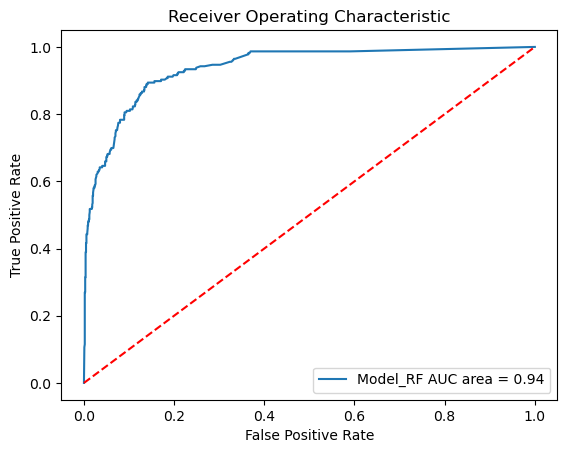

In [85]:
# Initialize the list that stores all models. First one is RF.
models = [{"label": "Model_RF", "model": model_RF}]
try:
    os.mkdir('results')
except:
    print("Directory already exists, continuing")
# Plot roc curve
plot_roc_curves_for_models(models, static_test_x, static_test_y)
result_img = '{}/results/roc_auc.png'.format(os.getcwd())
result_img


In [86]:
# Specify model
model_SVM = svm.SVC(kernel="rbf", C=1, gamma=0.1, probability=True)

# Fit model on single split
performance_measures = model_training_and_validation(model_SVM, "SVM", splits)


Sensitivity: 0.68
Specificity: 0.96
AUC: 0.92


'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn/results/roc_auc.png'

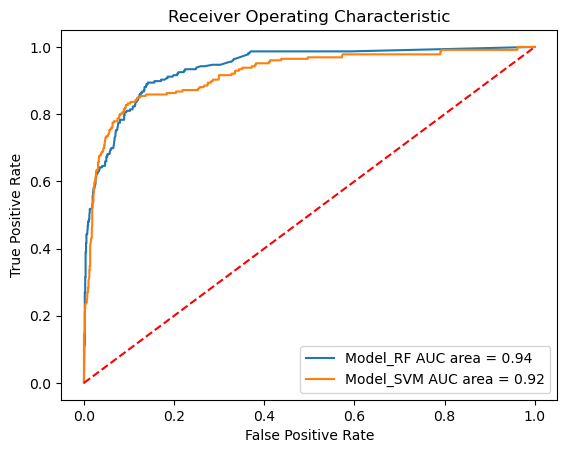

In [87]:
# Append SVM model
models.append({"label": "Model_SVM", "model": model_SVM})
# Plot roc curve
plot_roc_curves_for_models(models, static_test_x, static_test_y)
result_img = '{}/results/roc_auc.png'.format(os.getcwd())
result_img


#### Neural network classifier
The last approach we try here is a neural network model. We train an MLPClassifier (Multi-layer Perceptron classifier) with 3 layers, each with 5 neurons. As before, we do the crossvalidation procedure and plot the results. For more information on MLP, see [sklearn MLPClassifier](http://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPClassifier.html).

In [88]:
# Specify model
model_ANN = MLPClassifier(hidden_layer_sizes=(5, 3), random_state=12)

# Fit model on single split
performance_measures = model_training_and_validation(model_ANN, "ANN", splits)

Sensitivity: 0.69
Specificity: 0.94
AUC: 0.93


'/home/jovyan/new-shared-data-4323ACMDDY_2526_S1-Copy1/3_DesignYourOwn/results/roc_auc.png'

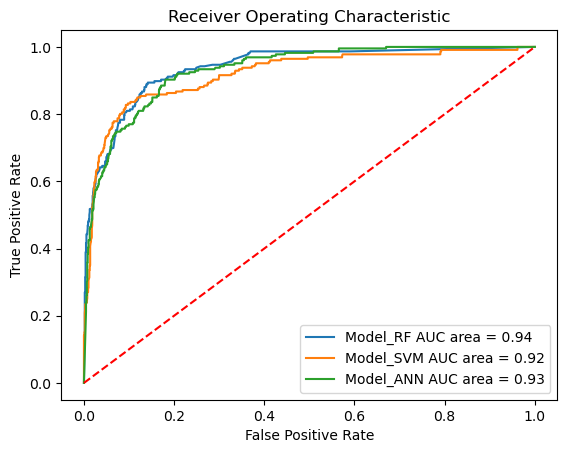

In [89]:
# Append ANN model
models.append({"label": "Model_ANN", "model": model_ANN})
# Plot roc curve
plot_roc_curves_for_models(models, static_test_x, static_test_y, True)
result_img = '{}/results/roc_auc.png'.format(os.getcwd())
result_img

#### Cross-validation

Next, we will perform cross-validation experiments with the three different models.
Therefore, we define a helper function for machine learning model training and validation in a cross-validation loop.

In [90]:
def crossvalidation(ml_model, df, n_folds=5, verbose=False):
    """
    Machine learning model training and validation in a cross-validation loop.

    Parameters
    ----------
    ml_model: sklearn model object
        The machine learning model to train.
    df: pd.DataFrame
        Data set with SMILES and their associated activity labels.
    n_folds: int, optional
        Number of folds for cross-validation.
    verbose: bool, optional
        Performance measures are printed.

    Returns
    -------
    None

    """
    t0 = time.time()
    # Shuffle the indices for the k-fold cross-validation
    kf = KFold(n_splits=n_folds, shuffle=True, random_state=SEED)

    # Results for each of the cross-validation folds
    acc_per_fold = []
    sens_per_fold = []
    spec_per_fold = []
    auc_per_fold = []

    # Loop over the folds
    for train_index, test_index in kf.split(df):
        # clone model -- we want a fresh copy per fold!
        fold_model = clone(ml_model)
        # Training

        # Convert the fingerprint and the label to a list
        train_x = df.iloc[train_index].fp.tolist()
        train_y = df.iloc[train_index].active.tolist()

        # Fit the model
        fold_model.fit(train_x, train_y)

        # Testing

        # Convert the fingerprint and the label to a list
        test_x = df.iloc[test_index].fp.tolist()
        test_y = df.iloc[test_index].active.tolist()

        # Performance for each fold
        accuracy, sens, spec, auc = model_performance(fold_model, test_x, test_y, verbose)

        # Save results
        acc_per_fold.append(accuracy)
        sens_per_fold.append(sens)
        spec_per_fold.append(spec)
        auc_per_fold.append(auc)

    # Print statistics of results
    print(
        f"Mean accuracy: {np.mean(acc_per_fold):.2f} \t"
        f"and std : {np.std(acc_per_fold):.2f} \n"
        f"Mean sensitivity: {np.mean(sens_per_fold):.2f} \t"
        f"and std : {np.std(sens_per_fold):.2f} \n"
        f"Mean specificity: {np.mean(spec_per_fold):.2f} \t"
        f"and std : {np.std(spec_per_fold):.2f} \n"
        f"Mean AUC: {np.mean(auc_per_fold):.2f} \t"
        f"and std : {np.std(auc_per_fold):.2f} \n"
        f"Time taken : {time.time() - t0:.2f}s\n"
    )

    return acc_per_fold, sens_per_fold, spec_per_fold, auc_per_fold
    

In [91]:
N_FOLDS = 3

In [92]:
for model in models:
    print("\n======= ")
    print(f"{model['label']}")
    crossvalidation(model["model"], compound_df, n_folds=N_FOLDS)


Model_RF
Mean accuracy: 0.91 	and std : 0.00 
Mean sensitivity: 0.68 	and std : 0.01 
Mean specificity: 0.96 	and std : 0.00 
Mean AUC: 0.94 	and std : 0.01 
Time taken : 1.93s


Model_SVM
Mean accuracy: 0.92 	and std : 0.01 
Mean sensitivity: 0.70 	and std : 0.00 
Mean specificity: 0.96 	and std : 0.01 
Mean AUC: 0.92 	and std : 0.00 
Time taken : 22.23s


Model_ANN
Mean accuracy: 0.90 	and std : 0.01 
Mean sensitivity: 0.67 	and std : 0.03 
Mean specificity: 0.94 	and std : 0.01 
Mean AUC: 0.93 	and std : 0.01 
Time taken : 7.25s



In [93]:
# Reset data frame
compound_df = compound_df.drop(['fp'], axis=1)

In [94]:
# Use Morgan fingerprint with radius 3
compound_df["fp"] = compound_df["Smiles"].apply(smiles_to_fp, args=("morgan3",))
compound_df.head(3)
# NBVAL_CHECK_OUTPUT

,Molecule ChEMBL ID,pChEMBL_value,Smiles,Assay_Type,Standard Relation,Standard Value,active,fp
0,CHEMBL2208420,7.9,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,B,'=',12.59,1.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, ..."
1,CHEMBL2208420,NaN,N#Cc1cccc(OCCCN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)c1,B,'>',70.00,0.0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, ..."
2,CHEMBL2208418,NaN,O[C@@H](CNC1CCN(Cc2ccc(Cl)c(Cl)c2)CC1)COc1ccc2...,B,'>',70.00,0.0,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."


In [95]:
for model in models:
    if model["label"] == "Model_SVM":
        # SVM is super slow with long fingerprints
        # and will have a performance similar to RF
        # We can skip it in this test, but if you want
        # to run it, feel free to replace `continue` with `pass`
        continue
    print("\n=======")
    print(model["label"])
    reduced_df = compound_df[['active','fp']]
    crossvalidation(model["model"], reduced_df, n_folds=N_FOLDS)


Model_RF
Mean accuracy: 0.92 	and std : 0.00 
Mean sensitivity: 0.70 	and std : 0.03 
Mean specificity: 0.96 	and std : 0.00 
Mean AUC: 0.94 	and std : 0.01 
Time taken : 12.79s


Model_ANN
Mean accuracy: 0.91 	and std : 0.00 
Mean sensitivity: 0.71 	and std : 0.04 
Mean specificity: 0.95 	and std : 0.01 
Mean AUC: 0.93 	and std : 0.01 
Time taken : 12.16s



In [96]:
def crossvalidation_reg(ml_model, df, n_folds=5, verbose=False):
    """
    Machine learning model training and validation in a cross-validation loop.

    Parameters
    ----------
    ml_model: sklearn model object
        The machine learning model to train.
    df: pd.DataFrame
        Data set with SMILES and their associated activity labels.
    n_folds: int, optional
        Number of folds for cross-validation.
    verbose: bool, optional
        Performance measures are printed.

    Returns
    -------
    None

    """
    t0 = time.time()
    # Shuffle the indices for the k-fold cross-validation
    kf = KFold(n_splits=n_folds, shuffle=True, random_state=SEED)

    # Results for each of the cross-validation folds
    MAE_per_fold = []
    RMSE_per_fold = []

    # Loop over the folds
    for train_index, test_index in kf.split(df):
        # clone model -- we want a fresh copy per fold!
        fold_model = clone(ml_model)
        # Training

        # Convert the fingerprint and the label to a list
        train_x = df.iloc[train_index].fp.tolist()
        train_y = df.iloc[train_index].pChEMBL_value.tolist()

        # Fit the model
        fold_model.fit(train_x, train_y)

        # Testing

        # Convert the fingerprint and the label to a list
        test_x = df.iloc[test_index].fp.tolist()
        test_y = df.iloc[test_index].pChEMBL_value.tolist()
        
        test_results = fold_model.predict(test_x)
        # Prediction probability on test set
        from sklearn import metrics

        MAE_per_fold.append(metrics.mean_absolute_error(test_y, test_results))
        #print('Mean Squared Error (MSE):', metrics.mean_squared_error(test_y, test_results))
        RMSE_per_fold.append(np.sqrt(metrics.mean_squared_error(test_y, test_results)))
        #mape = np.mean(np.abs((gt - pred) / np.abs(gt)))
        #print('Mean Absolute Percentage Error (MAPE):', round(mape * 100, 2))
        #print('Accuracy:', round(100*(1 - mape), 2))
    return(MAE_per_fold,RMSE_per_fold,fold_model)

In [97]:
#fingerprint_to_model = compound_df.fp.tolist()
# Convert the list of fingerprints into a 2D NumPy array
fingerprint_to_model = np.array(compound_df.fp.tolist())

label_to_model = compound_df.pChEMBL_value.tolist()

# Split data randomly in train and test set
# note that we use test/train_x for the respective fingerprint splits
# and test/train_y for the respective label splits
(
    static_train_x,
    static_test_x,
    static_train_y,
    static_test_y,
) = train_test_split(fingerprint_to_model, label_to_model, test_size=0.2, random_state=12)
splits = [static_train_x, static_test_x, static_train_y, static_test_y]
# NBVAL_CHECK_OUTPUT
print("Training data size:", len(static_train_x))
print("Test data size:", len(static_test_x))

Training data size: 5255
Test data size: 1314


In [98]:
# Kick out NaN in the pChEMBL values
compound_df_noNaN = compound_df.dropna()

# Append RF Regressor model
#models.append({"label": "Model_RF_reg", "model": RandomForestRegressor})
#Train model with RandomForestRegressor
regressor = RandomForestRegressor()
MAE, RMSE,trained_model = crossvalidation_reg(regressor , compound_df_noNaN, n_folds=N_FOLDS)

print(
f"MAE: {np.mean(MAE):.2f} \t"
f"and std : {np.std(MAE):.2f} \n"
f"RMSE: {np.mean(RMSE):.2f} \t"
f"and std : {np.std(RMSE):.2f} \n"
)

MAE: 0.60 	and std : 0.02 
RMSE: 0.86 	and std : 0.03 



In [99]:
# The first entry is the co-crystalized ligand 
# which is added for reference (so we can compare 
# to its actual pChEMBL value)
# BELOW: add your own molecules
test_smiles = [
    
 'CN(C)CC/C=C/1\C2=CC=CC=C2COC3=CC=CC=C31', #5EH
    'COC1=CC=C2C(CCC3=CC=CC=C3\C2=C/CCN(C)C)=C1', #1
    'CN(C)CC\C=C1/C2=CC=CC=C2COC2=CC3=C(C=C(Br)C=C3)C=C12', #2
    'CN(C)CC\C=C1/C2=CC=CC=C2CCC2=CC(O)=CC=C12', #3
    'CN(C)CCC=C1C2=CC=C(O)C=C2CCC2=CC(O)=CC=C12', #4
    'COC1=CC=C2C(OCC3=CC=CC=C3\C2=C/CCN(C)C)=C1', #5
    'CN(C)CC\C=C1/C2=CC=CC=C2COC2=CC3=C(C=C(F)C=C3)C=C12', #6
    'CN(C)CC\C=C1\C2=CC=CC=C2CCC2=C(O)C=CC=C12', #7
    'FCC\C=C1/C2=CC=CC=C2COC2=CC=CC=C12', #8
    'FC(F)(F)C\C=C1/C2=CC=CC=C2COC2=CC=CC=C12', #9
    'CN(C)CC\C=C1/C2=CC=C(C=C2COC2=CC=CC=C12)C(F)(F)F', #10

]

fps = []

for smiles in test_smiles: 
    fp = smiles_to_fp(smiles,'morgan3')
    fps.append(fp)

predictions = trained_model.predict(fps)
for i, prediction in enumerate(predictions):
    print('{},{:.2f}'.format(test_smiles[i], prediction))


CN(C)CC/C=C/1\C2=CC=CC=C2COC3=CC=CC=C31,9.55
COC1=CC=C2C(CCC3=CC=CC=C3\C2=C/CCN(C)C)=C1,8.06
CN(C)CC\C=C1/C2=CC=CC=C2COC2=CC3=C(C=C(Br)C=C3)C=C12,8.79
CN(C)CC\C=C1/C2=CC=CC=C2CCC2=CC(O)=CC=C12,8.21
CN(C)CCC=C1C2=CC=C(O)C=C2CCC2=CC(O)=CC=C12,7.49
COC1=CC=C2C(OCC3=CC=CC=C3\C2=C/CCN(C)C)=C1,9.04
CN(C)CC\C=C1/C2=CC=CC=C2COC2=CC3=C(C=C(F)C=C3)C=C12,8.87
CN(C)CC\C=C1\C2=CC=CC=C2CCC2=C(O)C=CC=C12,8.00
FCC\C=C1/C2=CC=CC=C2COC2=CC=CC=C12,6.61
FC(F)(F)C\C=C1/C2=CC=CC=C2COC2=CC=CC=C12,6.47
CN(C)CC\C=C1/C2=CC=C(C=C2COC2=CC=CC=C12)C(F)(F)F,8.65


## 3. Docking

# Molecular docking

In this lab, we will perform molecular docking on the SMILES strings you generated in the Machine Learning lab. We will also use the prepared protein from the first lab.

## Content of this notebook

1. Feching system and cleanup
2. System Visualization 
3. Docking with AutoDock Vina
    - Receptor preparation
    - Ligand preparation
    - Docking box definition
    - Docking
    - 3D visualization of docking results

In [100]:
#from pymol import cmd
import py3Dmol

import pandas as pd
import glob
import sys

from vina import Vina
#import pybel

from rdkit import Chem
from rdkit.Chem import AllChem, Draw

#from meeko import MoleculePreparation
#from meeko import obutils

import MDAnalysis as mda
from MDAnalysis.coordinates import PDB

#import prolif
#from prolif.plotting.network import LigNetwork

import nglview
from scripts import viewer

import sys, os, shutil
sys.path.insert(1, '/project/jhllei001/JHL_data/Jupyter_Dock/utilities')
# Note I had to comment out pymol, openmm and pdbfixer, hope it doesn't break later
#from utils import fix_protein, getbox, generate_ledock_file, pdbqt_to_sdf, dok_to_sdf

import warnings
warnings.filterwarnings("ignore")
%config Completer.use_jedi = False

In [101]:
from pathlib import Path
HOMEDIR = str(Path.home())
os.chdir(HOMEDIR)
# We need to check whether the directory is there
try:
    os.mkdir('Docking')
except:
    print("Directory already exists")
os.chdir('Docking')

Directory already exists


## 1. Feching system and cleanup

Next, we will copy back the prepared protein from the previous lab in this folder. Note that we will only work with the on-target here, so we only need to copy that:

In [102]:
PDBCODE = '3RZE' # As in lab 1, change this to your PDB accession code.
LIGAND_CODE = '5EH' # and add the ligand code
shutil.copy('../Bioinformatics/{}_prepped.pdb'.format(PDBCODE), '{}_prepped.pdb'.format(PDBCODE))
shutil.copy('../Bioinformatics/ligand-{}.pdb'.format(LIGAND_CODE), 'ligand-{}.pdb'.format(LIGAND_CODE))

'ligand-5EH.pdb'

In [103]:
test_smiles = [
    
 'CN(C)CC/C=C/1\C2=CC=CC=C2COC3=CC=CC=C31', #5EH
    'COC1=CC=C2C(CCC3=CC=CC=C3\C2=C/CCN(C)C)=C1', #1
    'CN(C)CC\C=C1/C2=CC=CC=C2COC2=CC3=C(C=C(Br)C=C3)C=C12', #2
    'CN(C)CC\C=C1/C2=CC=CC=C2CCC2=CC(O)=CC=C12', #3
    'CN(C)CCC=C1C2=CC=C(O)C=C2CCC2=CC(O)=CC=C12', #4
    'COC1=CC=C2C(OCC3=CC=CC=C3\C2=C/CCN(C)C)=C1', #5
    'CN(C)CC\C=C1/C2=CC=CC=C2COC2=CC3=C(C=C(F)C=C3)C=C12', #6
    'CN(C)CC\C=C1\C2=CC=CC=C2CCC2=C(O)C=CC=C12', #7
    'FCC\C=C1/C2=CC=CC=C2COC2=CC=CC=C12', #8
    'FC(F)(F)C\C=C1/C2=CC=CC=C2COC2=CC=CC=C12', #9
    'CN(C)CC\C=C1/C2=CC=C(C=C2COC2=CC=CC=C12)C(F)(F)F', #10

]

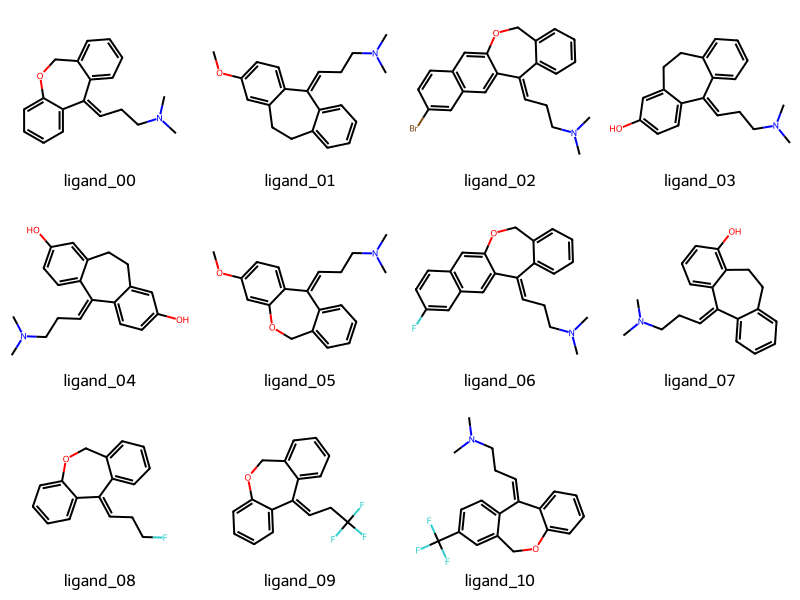

In [104]:
i = -1

IDs = []
for i in range(0,len(test_smiles)):
    base = 'ligand_{:02d}'.format(i)
    IDs.append(base)
    
df = pd.DataFrame({'ID':IDs, 'SMILES':test_smiles})

df['rdkit_mol'] = [Chem.MolFromSmiles(s) for s in df['SMILES']]

# Generate 2D images of the molecules
img=Draw.MolsToGridImage(df['rdkit_mol'].tolist(),
                            molsPerRow=4,
                            subImgSize=(200,200),
                            legends=df['ID'].tolist())

for i in range(len(df)):
    row = df.iloc[i]
    mol = row['rdkit_mol']
    name = row['ID'] + '.mol'
    Chem.MolToMolFile(mol,name)

img


## 2. System Visualization

Next, let's have a look again at the structure:

In [105]:
view = py3Dmol.view()
view.removeAllModels()
view.setViewStyle({'style':'outline','color':'black','width':0.1})

view.addModel(open('{}_prepped.pdb'.format(PDBCODE),'r').read(),format='pdb')
Prot=view.getModel()
Prot.setStyle({'cartoon':{'arrows':True, 'tubes':True, 'style':'oval', 'color':'white'}})
view.addSurface(py3Dmol.VDW,{'opacity':0.6,'color':'white'})


view.addModel(open('ligand_00.mol','r').read(),format='mol2')
ref_m = view.getModel()
ref_m.setStyle({},{'stick':{'colorscheme':'greenCarbon','radius':0.2}})

ligtmp = 'ligand-{}.pdb'.format(LIGAND_CODE)
view.addModelsAsFrames(open(ligtmp,'r').read(),format='pdb')
ref_m = view.getModel()
ref_m.setStyle({},{'stick':{'colorscheme':'magentaCarbon','radius':0.2}})

view.zoomTo()
view.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## 3. Docking with AutoDock Vina

AutoDock Vina (Vina) is one of the docking engines in the AutoDock Suite, together with AutoDock4 (AD4), AutoDockGPU, AutoDockFR, and AutoDock-CrankPep, and arguably among the most widely used and successful docking engines. The reasons for this success are mostly due to its ease of use and its speed (up to 100x faster than AD4), when compared to the other docking engines in the suite and elsewhere, as well as being open source.

### 3.1. Protein and ligand preparation

After sanitization, the protein docking preparation includes converting it to the PDBQT file format, which stores the atomic coordinates, partial charges, and AutoDock atom types for both the receptor and the ligand. 

We will prepare both the protein, and all of your molecules

In [106]:
from math import isnan, isinf

def PDBQTAtomLines(mol, donors, acceptors):
    """Create a list with PDBQT atom lines for each atom in molecule. Donors
    and acceptors are given as a list of atom indices.
    """

    atom_lines = [line.replace('HETATM', 'ATOM  ')
                  for line in Chem.MolToPDBBlock(mol).split('\n')
                  if line.startswith('HETATM') or line.startswith('ATOM')]

    pdbqt_lines = []
    for idx, atom in enumerate(mol.GetAtoms()):
        pdbqt_line = atom_lines[idx][:56]

        pdbqt_line += '0.00  0.00    '  # append empty vdW and ele
        # Get charge
        charge = 0.
        fields = ['_MMFF94Charge', '_GasteigerCharge', '_TriposPartialCharge']
        for f in fields:
            if atom.HasProp(f):
                charge = atom.GetDoubleProp(f)
                break
        # FIXME: this should not happen, blame RDKit
        if isnan(charge) or isinf(charge):
            charge = 0.
        pdbqt_line += ('%.3f' % charge).rjust(6)

        # Get atom type
        pdbqt_line += ' '
        atomicnum = atom.GetAtomicNum()
        if atomicnum == 6 and atom.GetIsAromatic():
            pdbqt_line += 'A'
        elif atomicnum == 7 and idx in acceptors:
            pdbqt_line += 'NA'
        elif atomicnum == 8 and idx in acceptors:
            pdbqt_line += 'OA'
        elif atomicnum == 1 and atom.GetNeighbors()[0].GetIdx() in donors:
            pdbqt_line += 'HD'
        else:
            pdbqt_line += atom.GetSymbol()
        pdbqt_lines.append(pdbqt_line)
    return pdbqt_lines

def MolToPDBQTBlock(mol, flexible=True, addHs=False, computeCharges=False):
    """Write RDKit Molecule to a PDBQT block

    Parameters
    ----------
        mol: rdkit.Chem.rdchem.Mol
            Molecule with a protein ligand complex
        flexible: bool (default=True)
            Should the molecule encode torsions. Ligands should be flexible,
            proteins in turn can be rigid.
        addHs: bool (default=False)
            The PDBQT format requires at least polar Hs on donors. By default Hs
            are added.
        computeCharges: bool (default=False)
            Should the partial charges be automatically computed. If the Hs are
            added the charges must and will be recomputed. If there are no
            partial charge information, they are set to 0.0.

    Returns
    -------
        block: str
            String wit PDBQT encoded molecule
    """
    # make a copy of molecule
    mol = Chem.Mol(mol)

    # if flexible molecule contains multiple fragments write them separately
    if flexible and len(Chem.GetMolFrags(mol)) > 1:
        return ''.join(MolToPDBQTBlock(frag, flexible=flexible, addHs=addHs,
                                       computeCharges=computeCharges)
                       for frag in Chem.GetMolFrags(mol, asMols=True))

    # Identify donors and acceptors for atom typing
    # Acceptors
    patt = Chem.MolFromSmarts('[$([O;H1;v2]),'
                              '$([O;H0;v2;!$(O=N-*),'
                              '$([O;-;!$(*-N=O)]),'
                              '$([o;+0])]),'
                              '$([n;+0;!X3;!$([n;H1](cc)cc),'
                              '$([$([N;H0]#[C&v4])]),'
                              '$([N&v3;H0;$(Nc)])]),'
                              '$([F;$(F-[#6]);!$(FC[F,Cl,Br,I])])]')
    acceptors = list(map(lambda x: x[0],
                         mol.GetSubstructMatches(patt, maxMatches=mol.GetNumAtoms())))
    # Donors
    patt = Chem.MolFromSmarts('[$([N&!H0&v3,N&!H0&+1&v4,n&H1&+0,$([$([Nv3](-C)(-C)-C)]),'
                              '$([$(n[n;H1]),'
                              '$(nc[n;H1])])]),'
                              # Guanidine can be tautormeic - e.g. Arginine
                              '$([NX3,NX2]([!O,!S])!@C(!@[NX3,NX2]([!O,!S]))!@[NX3,NX2]([!O,!S])),'
                              '$([O,S;H1;+0])]')
    donors = list(map(lambda x: x[0],
                      mol.GetSubstructMatches(patt, maxMatches=mol.GetNumAtoms())))
    if addHs:
        mol = Chem.AddHs(mol, addCoords=True, onlyOnAtoms=donors, )
    if addHs or computeCharges:
        AllChem.ComputeGasteigerCharges(mol)

    atom_lines = PDBQTAtomLines(mol, donors, acceptors)
    assert len(atom_lines) == mol.GetNumAtoms()

    pdbqt_lines = []

    # vina scores
    if (mol.HasProp('vina_affinity') and mol.HasProp('vina_rmsd_lb') and
            mol.HasProp('vina_rmsd_lb')):
        pdbqt_lines.append('REMARK VINA RESULT:  ' +
                           ('%.1f' % float(mol.GetProp('vina_affinity'))).rjust(8) +
                           ('%.3f' % float(mol.GetProp('vina_rmsd_lb'))).rjust(11) +
                           ('%.3f' % float(mol.GetProp('vina_rmsd_ub'))).rjust(11))

    pdbqt_lines.append('REMARK  Name = ' +
                       (mol.GetProp('_Name') if mol.HasProp('_Name') else ''))
    if flexible:
        # Find rotatable bonds
        rot_bond = Chem.MolFromSmarts('[!$(*#*)&!D1&!$(C(F)(F)F)&'
                                      '!$(C(Cl)(Cl)Cl)&'
                                      '!$(C(Br)(Br)Br)&'
                                      '!$(C([CH3])([CH3])[CH3])&'
                                      '!$([CD3](=[N,O,S])-!@[#7,O,S!D1])&'
                                      '!$([#7,O,S!D1]-!@[CD3]=[N,O,S])&'
                                      '!$([CD3](=[N+])-!@[#7!D1])&'
                                      '!$([#7!D1]-!@[CD3]=[N+])]-!@[!$(*#*)&'
                                      '!D1&!$(C(F)(F)F)&'
                                      '!$(C(Cl)(Cl)Cl)&'
                                      '!$(C(Br)(Br)Br)&'
                                      '!$(C([CH3])([CH3])[CH3])]')
        bond_atoms = list(mol.GetSubstructMatches(rot_bond))
        num_torsions = len(bond_atoms)

        # Active torsions header
        pdbqt_lines.append('REMARK  %i active torsions:' % num_torsions)
        pdbqt_lines.append('REMARK  status: (\'A\' for Active; \'I\' for Inactive)')
        for i, (a1, a2) in enumerate(bond_atoms):
            pdbqt_lines.append('REMARK%5.0i  A    between atoms: _%i  and  _%i'
                               % (i + 1, a1 + 1, a2 + 1))

        # Fragment molecule on bonds to ge rigid fragments
        bond_ids = [mol.GetBondBetweenAtoms(a1, a2).GetIdx()
                    for a1, a2 in bond_atoms]
        if bond_ids:
            mol_rigid_frags = Chem.FragmentOnBonds(mol, bond_ids, addDummies=False)
        else:
            mol_rigid_frags = mol
        frags = list(Chem.GetMolFrags(mol_rigid_frags))

        def weigh_frags(frag):
            """sort by the fragment size and the number of bonds (secondary)"""
            num_bonds = 0
            # bond_weight = 0
            for a1, a2 in bond_atoms:
                if a1 in frag or a2 in frag:
                    num_bonds += 1
                    # for frag2 in frags:
                    #     if a1 in frag2 or a2 in frag2:
                    #         bond_weight += len(frag2)

            # changed signs are fixing mixed sorting type (ascending/descending)
            return -len(frag), -num_bonds,  # bond_weight
        frags = sorted(frags, key=weigh_frags)

        # Start writting the lines with ROOT
        pdbqt_lines.append('ROOT')
        frag = frags.pop(0)
        for idx in frag:
            pdbqt_lines.append(atom_lines[idx])
        pdbqt_lines.append('ENDROOT')

        # Now build the tree of torsions usign DFS algorithm. Keep track of last
        # route with following variables to move down the tree and close branches
        branch_queue = []
        current_root = frag
        old_roots = [frag]

        visited_frags = []
        visited_bonds = []
        while len(frags) > len(visited_frags):
            end_branch = True
            for frag_num, frag in enumerate(frags):
                for bond_num, (a1, a2) in enumerate(bond_atoms):
                    if (frag_num not in visited_frags and
                        bond_num not in visited_bonds and
                        (a1 in current_root and a2 in frag or
                         a2 in current_root and a1 in frag)):
                        # direction of bonds is important
                        if a1 in current_root:
                            bond_dir = '%i %i' % (a1 + 1, a2 + 1)
                        else:
                            bond_dir = '%i %i' % (a2 + 1, a1 + 1)
                        pdbqt_lines.append('BRANCH %s' % bond_dir)
                        for idx in frag:
                            pdbqt_lines.append(atom_lines[idx])
                        branch_queue.append('ENDBRANCH %s' % bond_dir)

                        # Overwrite current root and stash previous one in queue
                        old_roots.append(current_root)
                        current_root = frag

                        # remove used elements from stack
                        visited_frags.append(frag_num)
                        visited_bonds.append(bond_num)

                        # mark that we dont want to end branch yet
                        end_branch = False
                        break
                    else:
                        continue
                    break  # break the outer loop as well

            if end_branch:
                pdbqt_lines.append(branch_queue.pop())
                if old_roots:
                    current_root = old_roots.pop()
        # close opened branches if any is open
        while len(branch_queue):
            pdbqt_lines.append(branch_queue.pop())
        pdbqt_lines.append('TORSDOF %i' % num_torsions)
    else:
        pdbqt_lines.extend(atom_lines)

    return '\n'.join(pdbqt_lines)

def MolFromPDBQTBlock(filename, sanitize=True, removeHs=True):
    """Read PDBQT block to a RDKit Molecule
    Parameters
    ----------
        block: string
            Residue name which explicitly pint to a ligand(s).
        sanitize: bool (default=True)
            Should the sanitization be performed
        removeHs: bool (default=True)
            Should hydrogens be removed when reading molecule.
    Returns
    -------
        mol: rdkit.Chem.rdchem.Mol
            Molecule read from PDBQT
    """
    pdb_lines = []
    name = ''
    data = {}
    with open(filename) as file:
        lines = file.readlines()
        block = [line.rstrip() for line in lines]
        
    for line in block: #.split('\n'):
        # Get all know data from REMARK section
        if line[:12] == 'REMARK  Name':
            name = line[15:].strip()
        elif line[:18] == 'REMARK VINA RESULT':
            tmp = line[19:].split()
            data['vina_affinity'] = tmp[0]
            data['vina_rmsd_lb'] = tmp[1]
            data['vina_rmsd_ub'] = tmp[2]

        # no more data to collect
        if line[:4] != 'ATOM':
            continue

        pdb_line = line[:56]
        pdb_line += '1.00  0.00           '

        # Do proper atom type lookup
        atom_type = line[71:].split()[1]
        if atom_type == 'A':
            atom_type = 'C'
        elif atom_type[:1] == 'O':
            atom_type = 'O'
        elif atom_type[:1] == 'H':
            atom_type = 'H'
            if removeHs:
                continue
        elif atom_type == 'NA':
            atom_type = 'N'

        pdb_lines.append(pdb_line + atom_type)
    mol = Chem.MolFromPDBBlock('\n'.join(pdb_lines), sanitize=False)
    if sanitize:
        Chem.SanitizeMol(mol)
    else:
        Chem.GetSSSR(mol)
    # reorder atoms using serial
    new_order = sorted(range(mol.GetNumAtoms()),
                       key=lambda i: (mol.GetAtomWithIdx(i)
                                      .GetPDBResidueInfo()
                                      .GetSerialNumber()))
    mol = Chem.RenumberAtoms(mol, new_order)

    # properties must be set on final copy of Mol, RenumberAtoms purges data
    mol.SetProp('_Name', name)
    for k, v in data.items():
        mol.SetProp(str(k), str(v))

    return mol

### 3.2. Box definition

It has been shown that using the radius of gyration, an efficient box can be generated for the docking process:
FROM: https://jcheminf.biomedcentral.com/articles/10.1186/s13321-015-0067-5
We will calculate the radius of gyration, as well as the center of geometry of the ligand to define the box size.

If you want to know more about this procedure, feel free to ask your TA!

In [107]:
import math

def Rg(filename):
    '''
    Calculates the Radius of Gyration (Rg) of a protein given its .pdb 
    structure file. Returns the Rg integer value in Angstrom.
    '''
    coord = list()
    mass = list()
    Structure = open(filename, 'r')
    for line in Structure:
        try:
            line = line.split()
            x = float(line[6])
            y = float(line[7])
            z = float(line[8])
            coord.append([x, y, z])
            if line[-1] == 'C':
                mass.append(12.0107)
            elif line[-1] == 'O':
                mass.append(15.9994)
            elif line[-1] == 'N':
                mass.append(14.0067)
            elif line[-1] == 'S':
                mass.append(32.065)
        except:
            pass
    xm = [(m*i, m*j, m*k) for (i, j, k), m in zip(coord, mass)]
    tmass = sum(mass)
    rr = sum(mi*i + mj*j + mk*k for (i, j, k), (mi, mj, mk) in zip(coord, xm))
    mm = sum((sum(i) / tmass)**2 for i in zip(*xm))
    rg = math.sqrt(rr / tmass-mm)
    return(round(rg, 3))

# Calculate the center based on the reference ligand
Rg = Rg('ligand-{}.pdb'.format(LIGAND_CODE))
print("Radius of Gyration = {}".format(Rg))

Radius of Gyration = 28.798


In [108]:
# Calculate center of geometry
def COG(pdbfile, include='ATOM,HETATM'):
    """
    Calculates center of geometry of a protein and/or ligand structure.
    Returns:
        center (list): List of float coordinates [x,y,z] that represent the
        center of geometry (precision 3).
    """

    center = [None, None, None]
    include = tuple(include.split(','))

    with open(pdbfile) as pdb:

        # extract coordinates [ [x1,y1,z1], [x2,y2,z2], ... ]
        coordinates = []
        for line in pdb:
            if line.startswith(include):
                coordinates.append([float(line[30:38]),    # x_coord
                                    float(line[38:46]),    # y_coord
                                    float(line[46:54])     # z_coord
                                   ])

        # calculate center of geometry
        center = [sum([coordinates[i][j]/(len(coordinates))
              for i in range(len(coordinates))]) for j in range(3)]
        center = [round(center[i], 3) for i in range(3)]
    return center

CenterOfGeometry = COG('ligand-{}.pdb'.format(LIGAND_CODE))
print("Center Of Geometry = {}".format(CenterOfGeometry))

Center Of Geometry = [16.893, 36.069, 21.994]


### 3.4. Docking

AutoDock Vina 1.2.0, which was recently released, now allows AutoDock Vina to be executed using Python Bindings.

We will run docking on each of your ligands seperately and visually inspect the results, so be prepared to come back to this section as many times as you generated molecules!

First, we prepare the protein and ligand using the functions we defined above:

In [109]:
protein = Chem.MolFromPDBFile('{}_prepped.pdb'.format(PDBCODE))
a = MolToPDBQTBlock(protein,flexible=False)
with open('protein.pdbqt','w') as outfile:
    for line in a:
        outfile.write(line)

In [110]:
# You can change the ligand name for each of the generated molecules from your smiles:
# So, ligand_00 (Should be the reference ligand from the crystal structure)
# Then, ligand_01, ligand_02, ... etc.
# Run one ligand at the time!
LIGAND_TO_DOCK = 'ligand_10' # Write the ligand you want to dock here.
m = Chem.MolFromMolFile('{}.mol'.format(LIGAND_TO_DOCK))
a = MolToPDBQTBlock(m)
with open('{}.pdbqt'.format(LIGAND_TO_DOCK), 'w') as outfile:
    for line in a:
        outfile.write(line)

In [111]:
Rg = 5

v = Vina(sf_name='vina')

v.set_receptor('protein.pdbqt')

v.set_ligand_from_file('{}.pdbqt'.format(LIGAND_TO_DOCK))

center = {
     'center_x' : CenterOfGeometry[0], 
     'center_y' : CenterOfGeometry[1], 
     'center_z' : CenterOfGeometry[2]
     
}

size = { 
    'size_x' : Rg * 2.9 ,
    'size_y' : Rg * 2.9,
    'size_z' : Rg * 2.9,           
           }
 

v.compute_vina_maps(center=[center['center_x'], center['center_y'], center['center_z']], 
                    box_size=[size['size_x'], size['size_y'], size['size_z']])

'''
# Score the current pose
energy = v.score()
print('Score before minimization: %.3f (kcal/mol)' % energy[0])

# Minimized locally the current pose
energy_minimized = v.optimize()
print('Score after minimization : %.3f (kcal/mol)' % energy_minimized[0])
v.write_pose('1iep_ligand_minimized.pdbqt', overwrite=True)
'''

# Dock the ligand
v.dock(exhaustiveness=10, n_poses=10)
v.write_poses('docking_results.pdbqt', n_poses=1, overwrite=True)

Computing Vina grid ... done.
Performing docking (random seed: -429586343) ... 
0%   10   20   30   40   50   60   70   80   90   100%
|----|----|----|----|----|----|----|----|----|----|
***************************************************


## Ligand_00 5EH
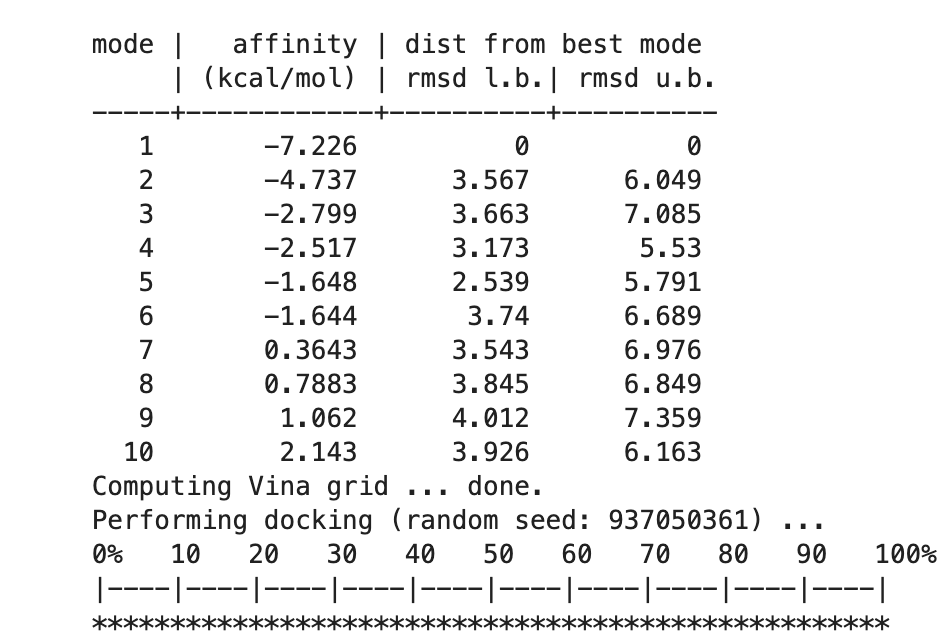

## Ligand_10
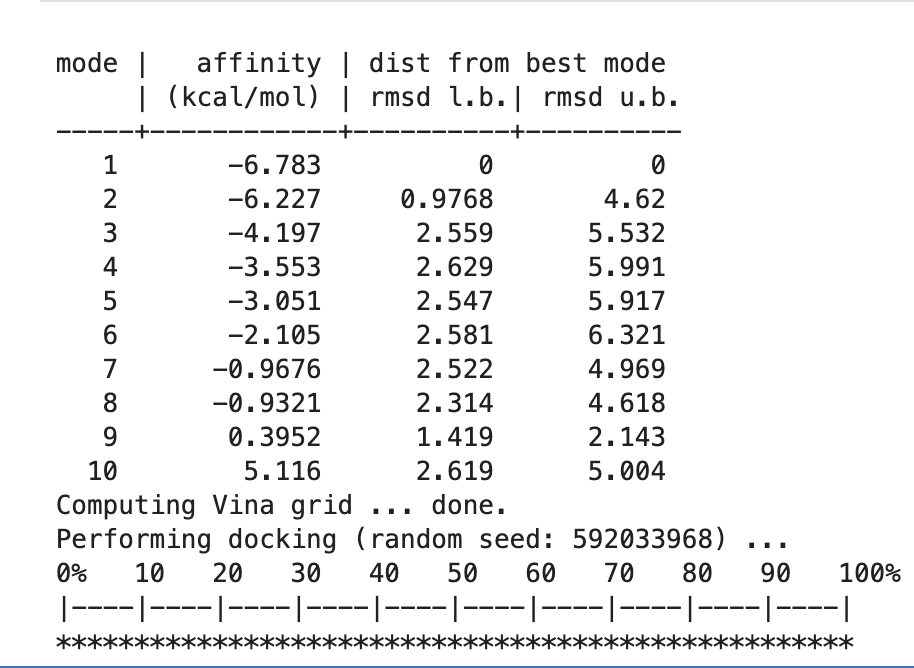

In [112]:
# Create a mol object from the docking results, write the mol to file and print the predicted affinity
mol = MolFromPDBQTBlock('docking_results.pdbqt',sanitize=False)
Chem.rdmolfiles.MolToPDBFile(mol, '{}_docked.pdb'.format(LIGAND_TO_DOCK))
Ki = (math.exp(float(mol.GetProp('vina_affinity'))/0.592))
pKi = -math.log10(Ki)
pChEMBL = pKi
print('The affinity predicted by Vina = {} (kcal/mol)'.format(mol.GetProp('vina_affinity')))
print('Which (approximately) corresponds to a pChEMBL of {:.2f}'.format(pKi))

The affinity predicted by Vina = -7.176 (kcal/mol)
Which (approximately) corresponds to a pChEMBL of 5.26


### 3.5. 3D visualization of docking results

As with the system visualization (section 3), the docking results can be inspected and compared to the reference structure (if exist). The ligand's "Pose" and "Score" information will also be displayed to show how acces to this molecule's attributes.

In [113]:
view = py3Dmol.view()
view.removeAllModels()
view.setViewStyle({'style':'outline','color':'black','width':0.1})

view.addModel(open('{}_prepped.pdb'.format(PDBCODE),'r').read(),format='pdb')
Prot=view.getModel()
Prot.setStyle({'cartoon':{'arrows':True, 'tubes':True, 'style':'oval', 'color':'white'}})
view.addSurface(py3Dmol.VDW,{'opacity':0.6,'color':'white'})

ligtmp = 'ligand-{}.pdb'.format(LIGAND_CODE)
view.addModels(open(ligtmp,'r').read(),format='pdb')
ref_m = view.getModel()
ref_m.setStyle({},{'stick':{'colorscheme':'magentaCarbon','radius':0.2}})

docktmp = '{}_docked.pdb'.format(LIGAND_TO_DOCK)
view.addModels(open(docktmp,'r').read(),format='pdb')
x = view.getModel()
x.setStyle({},{'stick':{'colorscheme':'cyanCarbon','radius':0.2}})

print('Reference: Magenta | Vina Pose: Cyan')

view.zoomTo()
view.show()

Reference: Magenta | Vina Pose: Cyan


3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [114]:
# combine protein and ligand files
filenames = [
'{}_prepped.pdb'.format(PDBCODE),
'{}_docked.pdb'.format(LIGAND_TO_DOCK)
]
with open('{}-complex.pdb'.format(PDBCODE), 'w') as outfile:
    for fname in filenames:
        with open(fname) as infile:
            for line in infile:
                if not "END" in line:
                    outfile.write(line)

In [115]:
# docktmp = '{}_docked.pdb'.format(LIGAND_TO_DOCK

with open('{}-complex.pdb'.format(PDBCODE)) as f:
    view = nglview.show_file(f, ext="pdb")
    
view.center("UNL")
viewer.show_residues_around(view, selection="UNL")
view

NGLWidget()

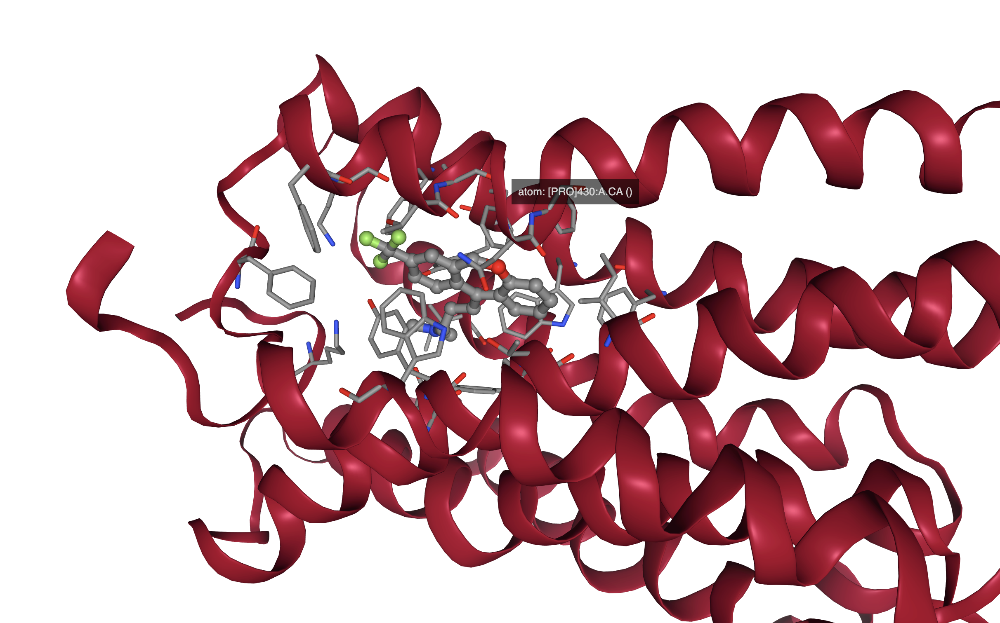

Docking results indicate that the designed CF₃-substituted ligand binds more strongly to the histamine H1 receptor than the reference ligand doxepin. The designed ligand achieved a Vina affinity of −7.226 kcal/mol (pChEMBL 5.30), compared to −6.783 kcal/mol (pChEMBL 4.98) for doxepin. This difference of ~0.4 kcal/mol suggests a modest but measurable improvement in predicted binding affinity. Importantly, both ligands maintained a dominant binding pose, consistent with the expected Asp107 salt-bridge interaction. These results support the potential of the designed analog as an optimized H1 antagonist scaffold.

## Q1: Does the ligand align well to your reference ligand?
		
    Yes. The redocking of the reference ligand (5EH, doxepin) produced a single dominant binding pose at −6.783 kcal/mol, consistent with the co-crystallized orientation in 3RZE. The designed ligand also adopted a dominant pose (−7.226 kcal/mol). Both retained the expected positioning of the protonated amine toward Asp107, suggesting correct alignment.
	

## Q2: Do the docking affinities match the Random Forest predictions?
		
    No, not directly.
	Random Forest QSAR predictions: All ligands were predicted highly active, with pChEMBL ≈ 8.62–8.66 (nanomolar range).
	•	Docking results: Lower potencies were estimated, with doxepin at pChEMBL ≈ 4.98 and the designed ligand at ≈ 5.30 (micromolar range).

This discrepancy reflects the different methods:
	
QSAR was trained on experimental HRH1 data and tends to be optimistic for analogs close to known chemotypes.
Docking evaluates only geometric fit and scoring functions, which underestimate absolute binding energies.

However, both methods agree on the trend: the designed ligand performs at least as well as, and in this case slightly better than, the reference ligand.


## Discussion and Conclusion 

In this project, the histamine H1 receptor was investigated as a target for the development of new antiallergic drugs. Doxepin, a potent but highly lipophilic reference ligand, served as the starting point. Although doxepin is clinically effective, its use is often limited by central side effects such as sedation, largely due to its high lipophilicity and the resulting increased penetration into the central nervous system (CNS). We combined bioinformatics, QSAR modeling, and molecular docking to design and evaluate novel ligands for the histamine H1 receptor. A total of ten ligands were designed with systematic modifications to the reference compound (5EH, doxepin), including halogenation, hydroxylation, and ring substitutions. Each design was assessed using both QSAR predictions and docking simulations. 

Docking results showed a wide range of predicted affinities, with values spanning pChEMBL ≈ 6.6–9.1. While several modifications reduced binding strength, others maintained activity close to the reference ligand. Importantly, Ligand 10, incorporating a CF₃ substituent, emerged as the best-designed analog, with a predicted pChEMBL of 8.87. This result suggests that the introduction of hydrophobic substituents such as CF₃ can enhance receptor interactions, whereas polar or bulky modifications often reduced activity. 

In conclusion, our computational pipeline successfully identified a lead candidate among the ten designed ligands. As future work, experimental testing is needed to validate binding, and further ligand optimization could explore additional substituents, heteroaromatic replacements, or linker modifications to achieve higher potency. Refining the QSAR training set and docking protocols may also improve predictive accuracy. 